In [1]:
import tensorflow as tf
import common
import pathlib
import matplotlib.pyplot as plt

In [2]:
class OutputLayer(tf.keras.layers.Layer):
    def __init__(self):
        super().__init__()
        self.dense1 = tf.keras.layers.Dense(256,activation=common.mish)
        self.dense2 = tf.keras.layers.Dense(32,activation=common.mish)
        self.dense3 = tf.keras.layers.Dense(4)
    def call(self,fm,training):
        x = tf.squeeze(fm,axis=[1,2])
        x = self.dense1(x)
        x = self.dense2(x)
        x = self.dense3(x)
        return x

In [3]:
class DwSubBlock(tf.keras.layers.Layer):
    def __init__(self,r=-1):
        super().__init__()
        self.depthwise_vf_outer = common.DepthwiseVisionField()
        self.decrease = common.DepthControl(r=r,a='mish')
        self.depthwise_vf_inner = common.DepthwiseVisionField()
        self.increase = common.DepthControl(r=-r,a='mish')
    def call(self,inp,training):
        x = self.depthwise_vf_outer(inp,training=training)
        x = self.decrease(x,training=training)
        x = self.depthwise_vf_inner(x,training=training)
        x = self.increase(x,training=training)
        return x
    
class SequentialDwSubBlock(tf.keras.layers.Layer):
    def __init__(self,repeat,r=-1):
        super().__init__()
        self.subblocks = [DwSubBlock(r=r) for _ in range(repeat)]
    def call(self,inp,training):
        x = inp
        for sb in self.subblocks:
            x = sb(x,training=training)
        return x

In [4]:
class Model(tf.keras.Model):
    def  __init__(self,levels=5,neck=2):
        super().__init__()
        self.dowmsamples = [common.DownSample(1),common.DownSample(2)]
        self.DwSubBlocks = [SequentialDwSubBlock(2),SequentialDwSubBlock(4),SequentialDwSubBlock(4)]
        self.ResBlockContracts = [common.ResBlockContract(2),common.ResBlockContract(4)]
        self.mixes = [common.DepthControl(r=-1,a='mish'),common.DepthControl(r=-1,a='mish')]
        self.Net = [
            common.ResBlockContract(repeat=4,r=-1),
            common.ResBlockContract(repeat=4,r=-1),
            common.ResBlockContract(repeat=6,r=-2),
            common.ResBlockContract(repeat=6,r=-2),
            common.ResBlockContract(repeat=2,r=-2),
        ]
        self.OutputLayer = OutputLayer()
        
    def call(self,image,training):
        fms = []
        
        fm = tf.tile(image,[1,1,1,16])
        fm = self.DwSubBlocks[0](fm,training=training)
        fms.append(fm)
        
        fm = self.dowmsamples[0](image,training=training)
        fm = tf.tile(fm,[1,1,1,32])
        fm = self.DwSubBlocks[1](fm,training=training)
        fms.append(fm)
        
        fm = self.dowmsamples[1](image,training=training)
        fm = tf.tile(fm,[1,1,1,64])
        fm = self.DwSubBlocks[2](fm,training=training)
        fms.append(fm)
        
        fm = self.ResBlockContracts[0](fms[0],training=training)
        fm = tf.concat([fm,fms[1]],axis=-1)
        fm = self.mixes[0](fm,training=training)
        
        fm = self.ResBlockContracts[1](fm,training=training)
        fm = tf.concat([fm,fms[2]],axis=-1)
        fm = self.mixes[1](fm,training=training)
        
        for N in self.Net:
            fm = N(fm,training=training)
        output = self.OutputLayer(fm,training=training)
        
        return output
        
    def predict(self,image):
        image = tf.image.resize(image,[128,128])
        if tf.rank(image) == 3:
            image = image[None,:,:,:]
        raw_xywh = self(image)
        xywh = tf.keras.activations.sigmoid(raw_xywh)
        return xywh

In [5]:
model = Model()

In [6]:
# model.load_weights(r'C:\Users\Atlas\Dropbox\DL_Competitions\ChinaSteel\Segmentation_Models\weights\model_3\0038\weights')

In [6]:
model.load_weights(r'C:\Users\user\Dropbox\DL_Competitions\ChinaSteel\Segmentation_Models\weights\model_3\0038\weights')

In [7]:
import FLAGS
import utils

FLAGS.MODEL = model
FLAGS.SAVE_WEIGHTS_PATH = 'model_3'

FLAGS.TRAIN.OPTIMIZER.TYPE = tf.keras.optimizers.Adam
FLAGS.TRAIN.OPTIMIZER.MAX_LR = 0.25 * 1e-3
FLAGS.TRAIN.EPOCH.TOTAL = 100
FLAGS.TRAIN.EPOCH.WARMUP = 3

FLAGS.TRAIN.RECORD_WEIGHTS_PATH = r'D:\DL_competition_Dataset\ChinaSteel\segment_model_weight\model_3\trial_2'
FLAGS.TRAIN.FOCAL_GAMMA = 0
# FLAGS.DATA.TRAIN.IMG_PATH = r'C:\Users\Atlas\Dropbox\DL_Competitions\ChinaSteel\Data'
FLAGS.DATA.TRAIN.IMG_PATH = r'D:\DL_competition_Dataset\ChinaSteel\public_training_data\public_training_data'
FLAGS.DATA.TRAIN.TABLE_PATH = pathlib.Path.cwd().parent.joinpath('Training Label','public_training_data.csv')
FLAGS.DATA.TRAIN.DROP_BAD_BBOX_DATA = True
FLAGS.DATA.TRAIN.IS_TOY = False
FLAGS.DATA.TRAIN.IMG_SIZE = (128,128)
FLAGS.DATA.TRAIN.BATCH_SIZE = 4
FLAGS.DATA.TRAIN.ARG = True
FLAGS.DATA.TRAIN.SHUFFLE = True
FLAGS.DATA.VALID.SPLIT_RATIO = 0.05
FLAGS.DATA.VALID.BATCH_SIZE = 32

# FLAGS.DATA.TEST.IMG_PATH = r'C:\Users\Atlas\Dropbox\DL_Competitions\ChinaSteel\Data'
FLAGS.DATA.TEST.IMG_PATH = r'D:\DL_competition_Dataset\ChinaSteel\public_training_data\public_testing_data'
FLAGS.DATA.TEST.BATCH_SIZE = 8
FLAGS.DATA.TEST.SHUFFLE = True

FLAGS.SEGMENT.BATCH_SIZE = 32
FLAGS.SEGMENT.TOLERANCE = 1.2
# FLAGS.SEGMENT.IMPORT_PATH = r'C:\Users\Atlas\Desktop\ChinaSteel_dataset\public\train\train_data'
# FLAGS.SEGMENT.IMPORT_PATH = r'D:\DL_competition_Dataset\ChinaSteel\dataset\public\test'
FLAGS.SEGMENT.IMPORT_PATH = r'D:\DL_competition_Dataset\ChinaSteel\dataset\private\original'
# FLAGS.SEGMENT.EXPORT_PATH = r'C:\Users\Atlas\Desktop\ChinaSteel_dataset\custom\train_segment'
# FLAGS.SEGMENT.EXPORT_PATH = r'D:\DL_competition_Dataset\ChinaSteel\dataset\custom\segment\test'
FLAGS.SEGMENT.EXPORT_PATH = r'D:\DL_competition_Dataset\ChinaSteel\dataset\private\segment\images'
# FLAGS.SEGMENT.COMPARE_PATH = r'C:\Users\Atlas\Desktop\ChinaSteel_dataset\custom\train_compare'
# FLAGS.SEGMENT.COMPARE_PATH = r'D:\DL_competition_Dataset\ChinaSteel\dataset\custom\segment\test_compare'
FLAGS.SEGMENT.COMPARE_PATH = r'D:\DL_competition_Dataset\ChinaSteel\dataset\private\segment\compare'

TRAIN GIOU loss: 0.92912 Focal: 0.92912
TRAIN GIOU loss: 0.92777 Focal: 0.92777
TRAIN GIOU loss: 0.92684 Focal: 0.92684
TRAIN GIOU loss: 0.92267 Focal: 0.92267
TRAIN GIOU loss: 0.91516 Focal: 0.91516
TRAIN GIOU loss: 0.89456 Focal: 0.89456
TRAIN GIOU loss: 0.86738 Focal: 0.86738
TRAIN GIOU loss: 0.84799 Focal: 0.84799
TRAIN GIOU loss: 0.83252 Focal: 0.83252
TRAIN GIOU loss: 0.81868 Focal: 0.81868
TRAIN GIOU loss: 0.80508 Focal: 0.80508
TRAIN GIOU loss: 0.79281 Focal: 0.79281
TRAIN GIOU loss: 0.78178 Focal: 0.78178
TRAIN GIOU loss: 0.77204 Focal: 0.77204
TRAIN GIOU loss: 0.76325 Focal: 0.76325
TRAIN GIOU loss: 0.75471 Focal: 0.75471
TRAIN GIOU loss: 0.74664 Focal: 0.74664
TRAIN GIOU loss: 0.73834 Focal: 0.73834
TRAIN GIOU loss: 0.73200 Focal: 0.73200
TRAIN GIOU loss: 0.72342 Focal: 0.72342
TRAIN GIOU loss: 0.71535 Focal: 0.71535
TRAIN GIOU loss: 0.70697 Focal: 0.70697
TRAIN GIOU loss: 0.69913 Focal: 0.69913
TRAIN GIOU loss: 0.69105 Focal: 0.69105
TRAIN GIOU loss: 0.68773 Focal: 0.68773


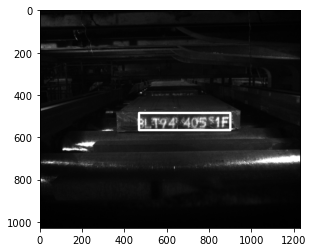

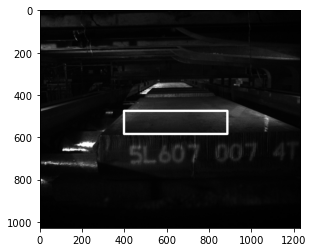

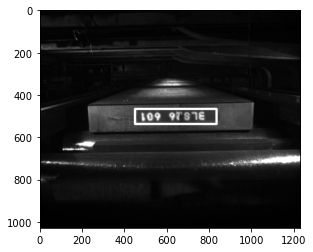

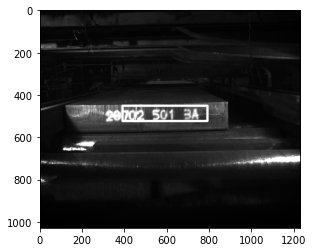

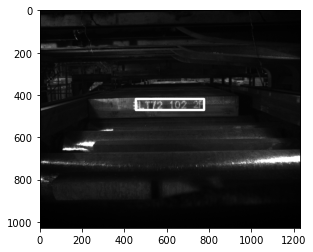

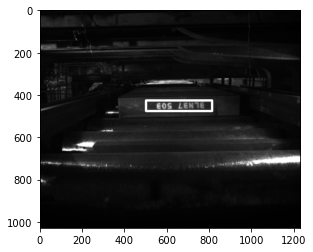

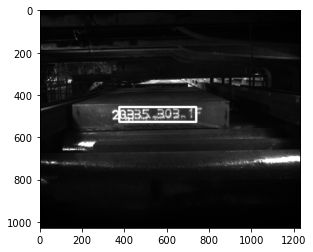

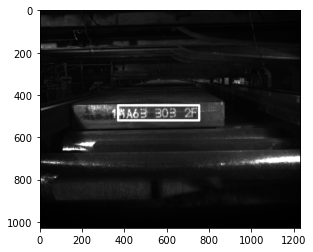

TRAIN GIOU loss: 0.33717 Focal: 0.33717
TRAIN GIOU loss: 0.40057 Focal: 0.40057
TRAIN GIOU loss: 0.38741 Focal: 0.38741
TRAIN GIOU loss: 0.39539 Focal: 0.39539
TRAIN GIOU loss: 0.39751 Focal: 0.39751
TRAIN GIOU loss: 0.39167 Focal: 0.39167
TRAIN GIOU loss: 0.38519 Focal: 0.38519
TRAIN GIOU loss: 0.38041 Focal: 0.38041
TRAIN GIOU loss: 0.38135 Focal: 0.38135
TRAIN GIOU loss: 0.37741 Focal: 0.37741
TRAIN GIOU loss: 0.37872 Focal: 0.37872
TRAIN GIOU loss: 0.37721 Focal: 0.37721
TRAIN GIOU loss: 0.37570 Focal: 0.37570
TRAIN GIOU loss: 0.37821 Focal: 0.37821
TRAIN GIOU loss: 0.37533 Focal: 0.37533
TRAIN GIOU loss: 0.37177 Focal: 0.37177
TRAIN GIOU loss: 0.37307 Focal: 0.37307
TRAIN GIOU loss: 0.37074 Focal: 0.37074
TRAIN GIOU loss: 0.36893 Focal: 0.36893
TRAIN GIOU loss: 0.37177 Focal: 0.37177
TRAIN GIOU loss: 0.37123 Focal: 0.37123
TRAIN GIOU loss: 0.37146 Focal: 0.37146
TRAIN GIOU loss: 0.37026 Focal: 0.37026
TRAIN GIOU loss: 0.37068 Focal: 0.37068
TRAIN GIOU loss: 0.37001 Focal: 0.37001


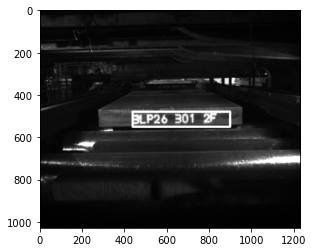

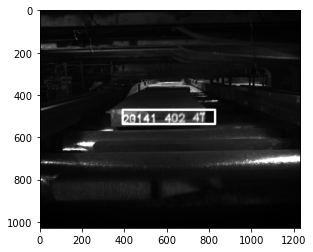

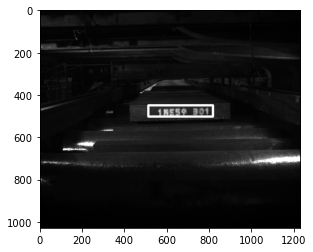

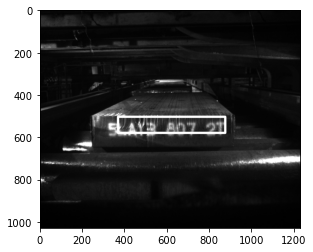

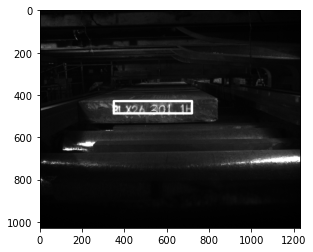

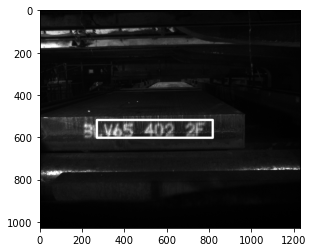

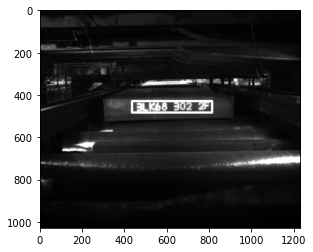

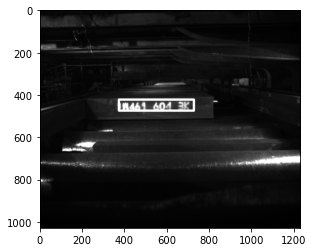

TRAIN GIOU loss: 0.29694 Focal: 0.29694
TRAIN GIOU loss: 0.31751 Focal: 0.31751
TRAIN GIOU loss: 0.30536 Focal: 0.30536
TRAIN GIOU loss: 0.31136 Focal: 0.31136
TRAIN GIOU loss: 0.31003 Focal: 0.31003
TRAIN GIOU loss: 0.31093 Focal: 0.31093
TRAIN GIOU loss: 0.31232 Focal: 0.31232
TRAIN GIOU loss: 0.30996 Focal: 0.30996
TRAIN GIOU loss: 0.30726 Focal: 0.30726
TRAIN GIOU loss: 0.30784 Focal: 0.30784
TRAIN GIOU loss: 0.30671 Focal: 0.30671
TRAIN GIOU loss: 0.30548 Focal: 0.30548
TRAIN GIOU loss: 0.30466 Focal: 0.30466
TRAIN GIOU loss: 0.30386 Focal: 0.30386
TRAIN GIOU loss: 0.30207 Focal: 0.30207
TRAIN GIOU loss: 0.30169 Focal: 0.30169
TRAIN GIOU loss: 0.30615 Focal: 0.30615
TRAIN GIOU loss: 0.30520 Focal: 0.30520
TRAIN GIOU loss: 0.30738 Focal: 0.30738
TRAIN GIOU loss: 0.30684 Focal: 0.30684
TRAIN GIOU loss: 0.30596 Focal: 0.30596
TRAIN GIOU loss: 0.30462 Focal: 0.30462
TRAIN GIOU loss: 0.30422 Focal: 0.30422
TRAIN GIOU loss: 0.30421 Focal: 0.30421
TRAIN GIOU loss: 0.30564 Focal: 0.30564


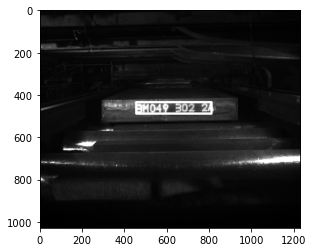

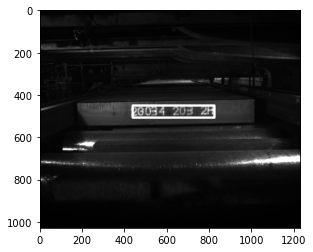

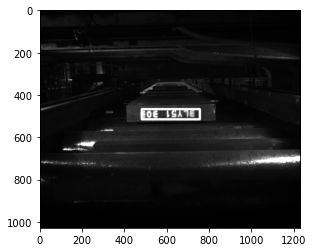

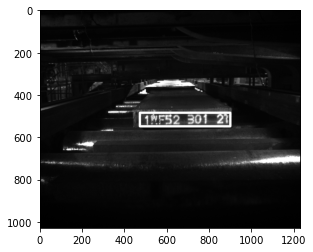

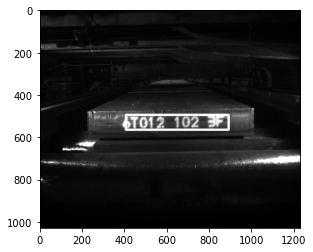

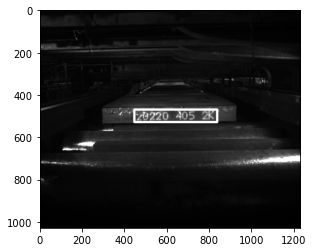

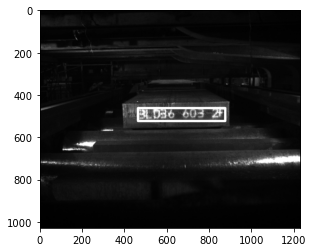

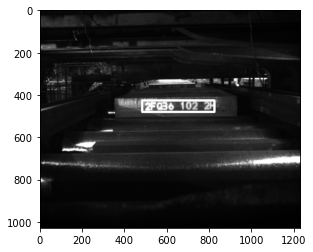

TRAIN GIOU loss: 0.19401 Focal: 0.19401
TRAIN GIOU loss: 0.25942 Focal: 0.25942
TRAIN GIOU loss: 0.28333 Focal: 0.28333
TRAIN GIOU loss: 0.27405 Focal: 0.27405
TRAIN GIOU loss: 0.27541 Focal: 0.27541
TRAIN GIOU loss: 0.28069 Focal: 0.28069
TRAIN GIOU loss: 0.27376 Focal: 0.27376
TRAIN GIOU loss: 0.26914 Focal: 0.26914
TRAIN GIOU loss: 0.26458 Focal: 0.26458
TRAIN GIOU loss: 0.26114 Focal: 0.26114
TRAIN GIOU loss: 0.25859 Focal: 0.25859
TRAIN GIOU loss: 0.26107 Focal: 0.26107
TRAIN GIOU loss: 0.26436 Focal: 0.26436
TRAIN GIOU loss: 0.26038 Focal: 0.26038
TRAIN GIOU loss: 0.26062 Focal: 0.26062
TRAIN GIOU loss: 0.25961 Focal: 0.25961
TRAIN GIOU loss: 0.25590 Focal: 0.25590
TRAIN GIOU loss: 0.25536 Focal: 0.25536
TRAIN GIOU loss: 0.25528 Focal: 0.25528
TRAIN GIOU loss: 0.25303 Focal: 0.25303
TRAIN GIOU loss: 0.25204 Focal: 0.25204
TRAIN GIOU loss: 0.25028 Focal: 0.25028
TRAIN GIOU loss: 0.24848 Focal: 0.24848
TRAIN GIOU loss: 0.24874 Focal: 0.24874
TRAIN GIOU loss: 0.24921 Focal: 0.24921


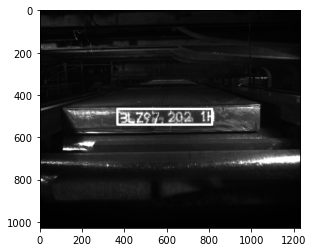

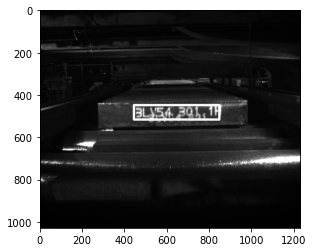

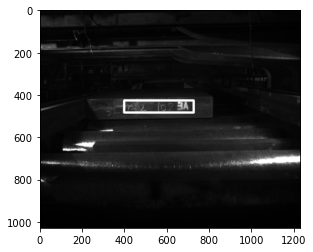

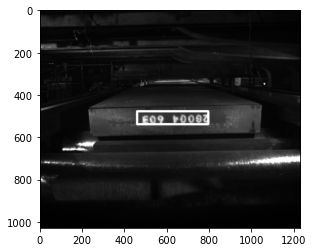

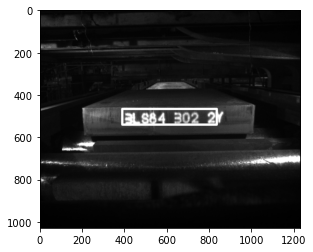

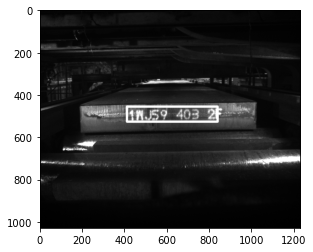

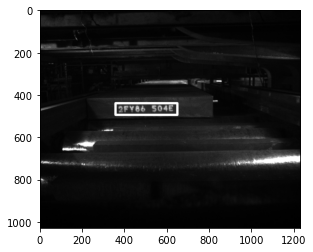

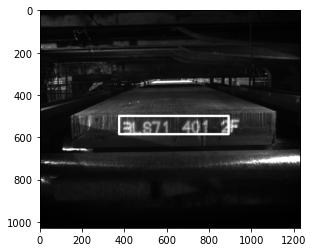

TRAIN GIOU loss: 0.20862 Focal: 0.20862
TRAIN GIOU loss: 0.21257 Focal: 0.21257
TRAIN GIOU loss: 0.21136 Focal: 0.21136
TRAIN GIOU loss: 0.21234 Focal: 0.21234
TRAIN GIOU loss: 0.21145 Focal: 0.21145
TRAIN GIOU loss: 0.21340 Focal: 0.21340
TRAIN GIOU loss: 0.21344 Focal: 0.21344
TRAIN GIOU loss: 0.21782 Focal: 0.21782
TRAIN GIOU loss: 0.21606 Focal: 0.21606
TRAIN GIOU loss: 0.21471 Focal: 0.21471
TRAIN GIOU loss: 0.21317 Focal: 0.21317
TRAIN GIOU loss: 0.21185 Focal: 0.21185
TRAIN GIOU loss: 0.20990 Focal: 0.20990
TRAIN GIOU loss: 0.20827 Focal: 0.20827
TRAIN GIOU loss: 0.20705 Focal: 0.20705
TRAIN GIOU loss: 0.20727 Focal: 0.20727
TRAIN GIOU loss: 0.20786 Focal: 0.20786
TRAIN GIOU loss: 0.20709 Focal: 0.20709
TRAIN GIOU loss: 0.20666 Focal: 0.20666
TRAIN GIOU loss: 0.20758 Focal: 0.20758
TRAIN GIOU loss: 0.20881 Focal: 0.20881
TRAIN GIOU loss: 0.20862 Focal: 0.20862
TRAIN GIOU loss: 0.20847 Focal: 0.20847
TRAIN GIOU loss: 0.20823 Focal: 0.20823
TRAIN GIOU loss: 0.20911 Focal: 0.20911


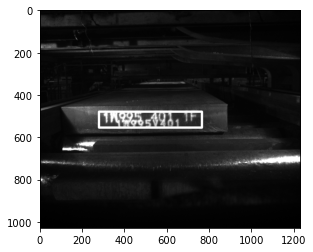

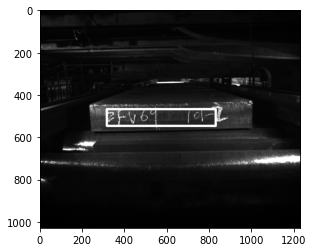

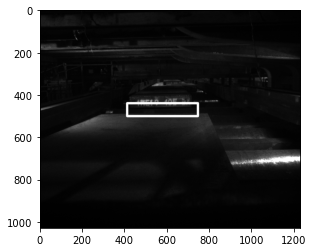

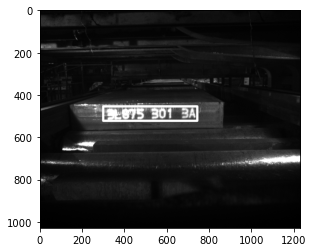

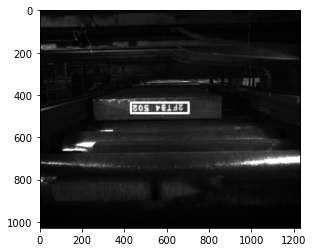

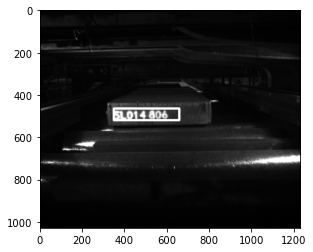

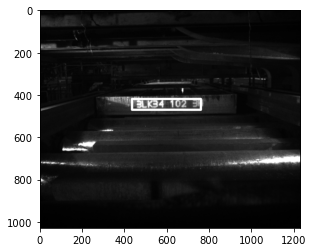

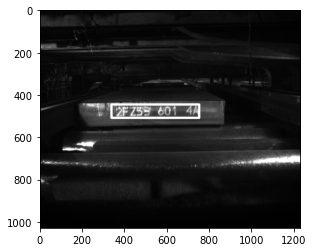

TRAIN GIOU loss: 0.18098 Focal: 0.18098
TRAIN GIOU loss: 0.19299 Focal: 0.19299
TRAIN GIOU loss: 0.19356 Focal: 0.19356
TRAIN GIOU loss: 0.18262 Focal: 0.18262
TRAIN GIOU loss: 0.18239 Focal: 0.18239
TRAIN GIOU loss: 0.18027 Focal: 0.18027
TRAIN GIOU loss: 0.18036 Focal: 0.18036
TRAIN GIOU loss: 0.18249 Focal: 0.18249
TRAIN GIOU loss: 0.18207 Focal: 0.18207
TRAIN GIOU loss: 0.18200 Focal: 0.18200
TRAIN GIOU loss: 0.18338 Focal: 0.18338
TRAIN GIOU loss: 0.18264 Focal: 0.18264
TRAIN GIOU loss: 0.18139 Focal: 0.18139
TRAIN GIOU loss: 0.18202 Focal: 0.18202
TRAIN GIOU loss: 0.18100 Focal: 0.18100
TRAIN GIOU loss: 0.18056 Focal: 0.18056
TRAIN GIOU loss: 0.17914 Focal: 0.17914
TRAIN GIOU loss: 0.17922 Focal: 0.17922
TRAIN GIOU loss: 0.17909 Focal: 0.17909
TRAIN GIOU loss: 0.17820 Focal: 0.17820
TRAIN GIOU loss: 0.17862 Focal: 0.17862
TRAIN GIOU loss: 0.17773 Focal: 0.17773
TRAIN GIOU loss: 0.17904 Focal: 0.17904
TRAIN GIOU loss: 0.17969 Focal: 0.17969
TRAIN GIOU loss: 0.18074 Focal: 0.18074


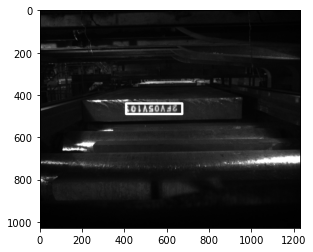

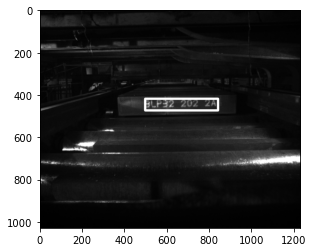

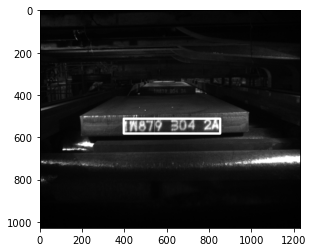

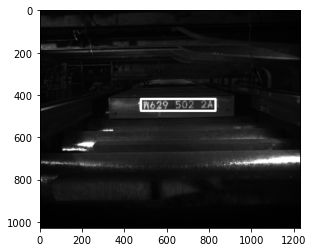

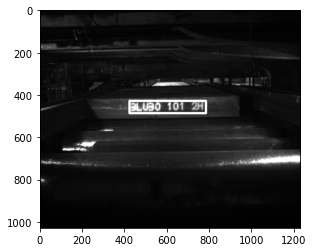

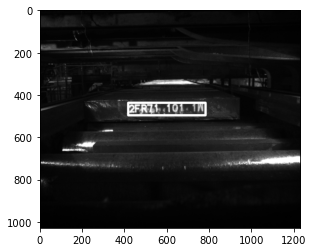

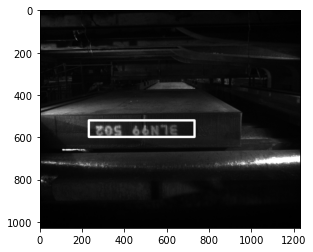

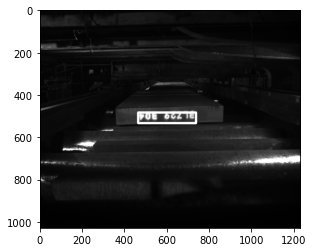

TRAIN GIOU loss: 0.16002 Focal: 0.16002
TRAIN GIOU loss: 0.15235 Focal: 0.15235
TRAIN GIOU loss: 0.15646 Focal: 0.15646
TRAIN GIOU loss: 0.15602 Focal: 0.15602
TRAIN GIOU loss: 0.15874 Focal: 0.15874
TRAIN GIOU loss: 0.15743 Focal: 0.15743
TRAIN GIOU loss: 0.16101 Focal: 0.16101
TRAIN GIOU loss: 0.16249 Focal: 0.16249
TRAIN GIOU loss: 0.16193 Focal: 0.16193
TRAIN GIOU loss: 0.16447 Focal: 0.16447
TRAIN GIOU loss: 0.16578 Focal: 0.16578
TRAIN GIOU loss: 0.16689 Focal: 0.16689
TRAIN GIOU loss: 0.16592 Focal: 0.16592
TRAIN GIOU loss: 0.16812 Focal: 0.16812
TRAIN GIOU loss: 0.16822 Focal: 0.16822
TRAIN GIOU loss: 0.16896 Focal: 0.16896
TRAIN GIOU loss: 0.16952 Focal: 0.16952
TRAIN GIOU loss: 0.16889 Focal: 0.16889
TRAIN GIOU loss: 0.16811 Focal: 0.16811
TRAIN GIOU loss: 0.16739 Focal: 0.16739
TRAIN GIOU loss: 0.16622 Focal: 0.16622
TRAIN GIOU loss: 0.16623 Focal: 0.16623
TRAIN GIOU loss: 0.16668 Focal: 0.16668
TRAIN GIOU loss: 0.16593 Focal: 0.16593
TRAIN GIOU loss: 0.16612 Focal: 0.16612


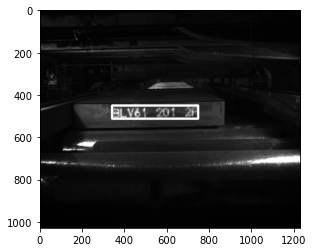

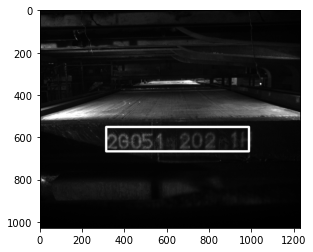

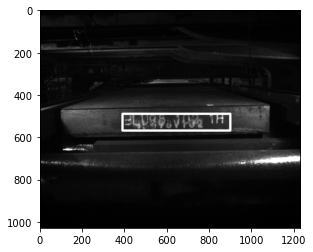

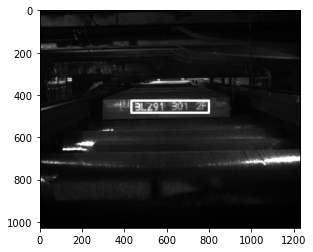

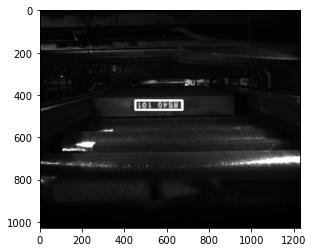

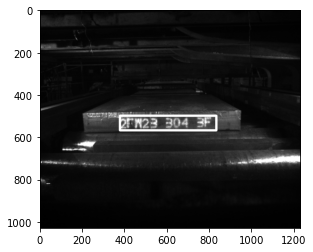

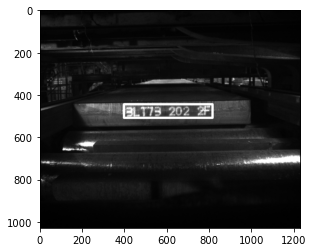

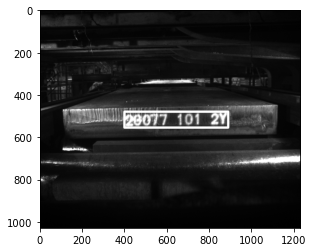

TRAIN GIOU loss: 0.14088 Focal: 0.14088
TRAIN GIOU loss: 0.14185 Focal: 0.14185
TRAIN GIOU loss: 0.14624 Focal: 0.14624
TRAIN GIOU loss: 0.14558 Focal: 0.14558
TRAIN GIOU loss: 0.14653 Focal: 0.14653
TRAIN GIOU loss: 0.14753 Focal: 0.14753
TRAIN GIOU loss: 0.14910 Focal: 0.14910
TRAIN GIOU loss: 0.15044 Focal: 0.15044
TRAIN GIOU loss: 0.15120 Focal: 0.15120
TRAIN GIOU loss: 0.15046 Focal: 0.15046
TRAIN GIOU loss: 0.15119 Focal: 0.15119
TRAIN GIOU loss: 0.15123 Focal: 0.15123
TRAIN GIOU loss: 0.15087 Focal: 0.15087
TRAIN GIOU loss: 0.15079 Focal: 0.15079
TRAIN GIOU loss: 0.15095 Focal: 0.15095
TRAIN GIOU loss: 0.14999 Focal: 0.14999
TRAIN GIOU loss: 0.15039 Focal: 0.15039
TRAIN GIOU loss: 0.15104 Focal: 0.15104
TRAIN GIOU loss: 0.15093 Focal: 0.15093
TRAIN GIOU loss: 0.15120 Focal: 0.15120
TRAIN GIOU loss: 0.15094 Focal: 0.15094
TRAIN GIOU loss: 0.15043 Focal: 0.15043
TRAIN GIOU loss: 0.14987 Focal: 0.14987
TRAIN GIOU loss: 0.14959 Focal: 0.14959
TRAIN GIOU loss: 0.14982 Focal: 0.14982


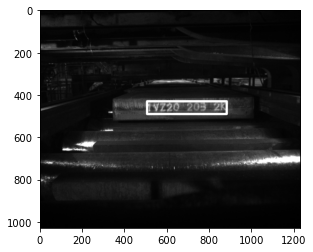

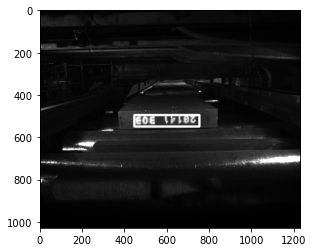

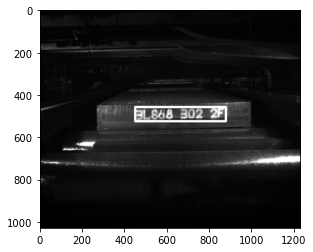

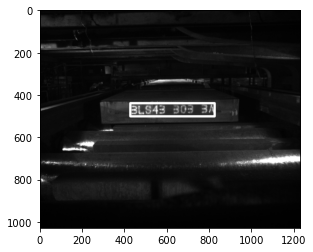

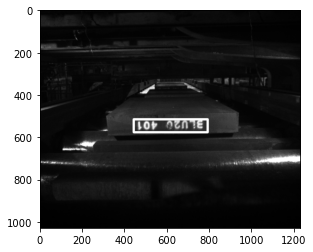

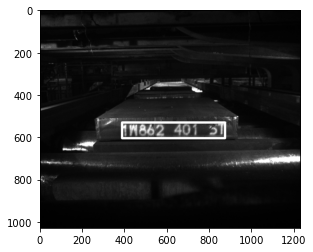

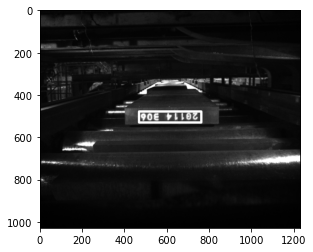

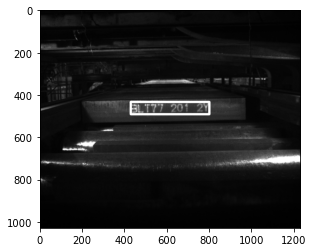

TRAIN GIOU loss: 0.12017 Focal: 0.12017
TRAIN GIOU loss: 0.13346 Focal: 0.13346
TRAIN GIOU loss: 0.13109 Focal: 0.13109
TRAIN GIOU loss: 0.13006 Focal: 0.13006
TRAIN GIOU loss: 0.13091 Focal: 0.13091
TRAIN GIOU loss: 0.13286 Focal: 0.13286
TRAIN GIOU loss: 0.13456 Focal: 0.13456
TRAIN GIOU loss: 0.13524 Focal: 0.13524
TRAIN GIOU loss: 0.13558 Focal: 0.13558
TRAIN GIOU loss: 0.13615 Focal: 0.13615
TRAIN GIOU loss: 0.13732 Focal: 0.13732
TRAIN GIOU loss: 0.13615 Focal: 0.13615
TRAIN GIOU loss: 0.13663 Focal: 0.13663
TRAIN GIOU loss: 0.13691 Focal: 0.13691
TRAIN GIOU loss: 0.13705 Focal: 0.13705
TRAIN GIOU loss: 0.13751 Focal: 0.13751
TRAIN GIOU loss: 0.13895 Focal: 0.13895
TRAIN GIOU loss: 0.13884 Focal: 0.13884
TRAIN GIOU loss: 0.13867 Focal: 0.13867
TRAIN GIOU loss: 0.13854 Focal: 0.13854
TRAIN GIOU loss: 0.13840 Focal: 0.13840
TRAIN GIOU loss: 0.13928 Focal: 0.13928
TRAIN GIOU loss: 0.13904 Focal: 0.13904
TRAIN GIOU loss: 0.13934 Focal: 0.13934
TRAIN GIOU loss: 0.13993 Focal: 0.13993


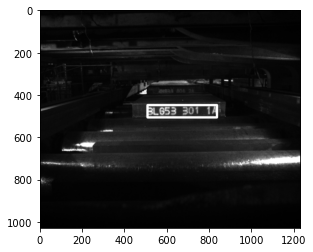

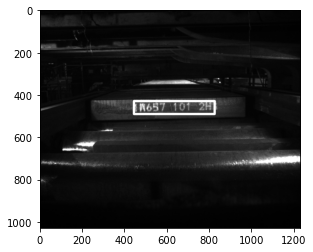

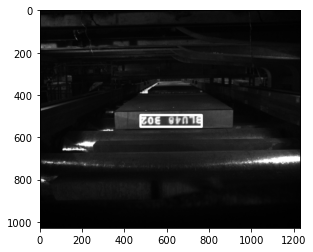

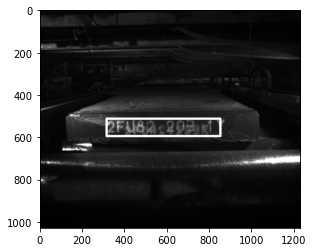

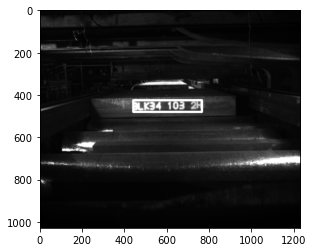

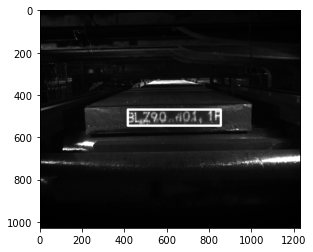

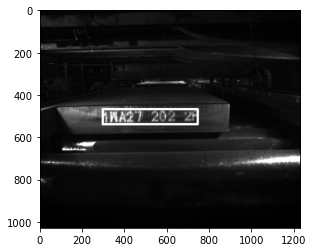

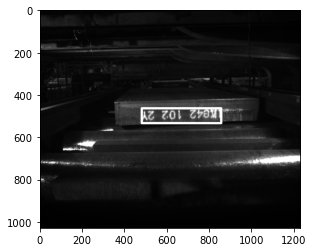

TRAIN GIOU loss: 0.15828 Focal: 0.15828
TRAIN GIOU loss: 0.13690 Focal: 0.13690
TRAIN GIOU loss: 0.13207 Focal: 0.13207
TRAIN GIOU loss: 0.13947 Focal: 0.13947
TRAIN GIOU loss: 0.14203 Focal: 0.14203
TRAIN GIOU loss: 0.13988 Focal: 0.13988
TRAIN GIOU loss: 0.13860 Focal: 0.13860
TRAIN GIOU loss: 0.13726 Focal: 0.13726
TRAIN GIOU loss: 0.13616 Focal: 0.13616
TRAIN GIOU loss: 0.13573 Focal: 0.13573
TRAIN GIOU loss: 0.13572 Focal: 0.13572
TRAIN GIOU loss: 0.13494 Focal: 0.13494
TRAIN GIOU loss: 0.13528 Focal: 0.13528
TRAIN GIOU loss: 0.13454 Focal: 0.13454
TRAIN GIOU loss: 0.13481 Focal: 0.13481
TRAIN GIOU loss: 0.13453 Focal: 0.13453
TRAIN GIOU loss: 0.13455 Focal: 0.13455
TRAIN GIOU loss: 0.13410 Focal: 0.13410
TRAIN GIOU loss: 0.13471 Focal: 0.13471
TRAIN GIOU loss: 0.13526 Focal: 0.13526
TRAIN GIOU loss: 0.13530 Focal: 0.13530
TRAIN GIOU loss: 0.13594 Focal: 0.13594
TRAIN GIOU loss: 0.13538 Focal: 0.13538
TRAIN GIOU loss: 0.13551 Focal: 0.13551
TRAIN GIOU loss: 0.13520 Focal: 0.13520


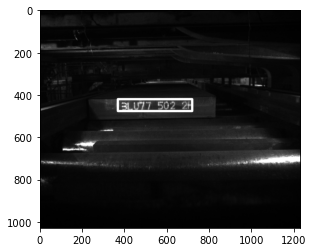

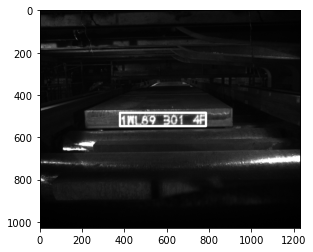

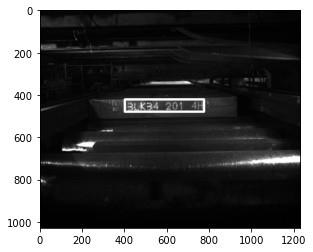

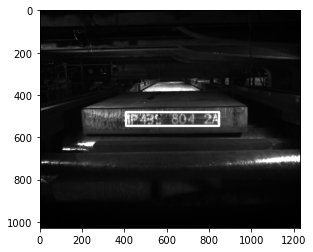

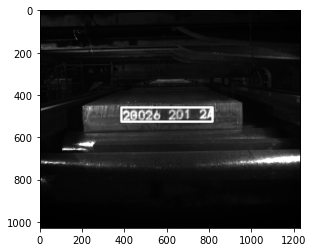

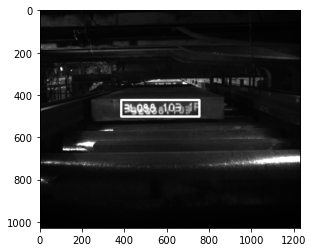

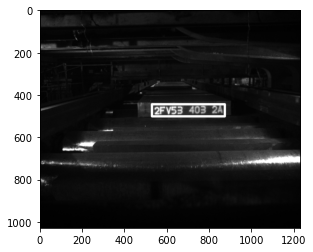

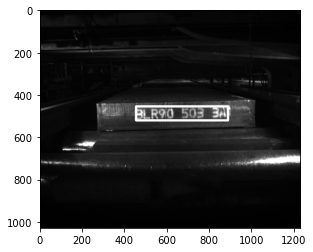

TRAIN GIOU loss: 0.13710 Focal: 0.13710
TRAIN GIOU loss: 0.14191 Focal: 0.14191
TRAIN GIOU loss: 0.13751 Focal: 0.13751
TRAIN GIOU loss: 0.13688 Focal: 0.13688
TRAIN GIOU loss: 0.13619 Focal: 0.13619
TRAIN GIOU loss: 0.13160 Focal: 0.13160
TRAIN GIOU loss: 0.12970 Focal: 0.12970
TRAIN GIOU loss: 0.12951 Focal: 0.12951
TRAIN GIOU loss: 0.12839 Focal: 0.12839
TRAIN GIOU loss: 0.12699 Focal: 0.12699
TRAIN GIOU loss: 0.12612 Focal: 0.12612
TRAIN GIOU loss: 0.12598 Focal: 0.12598
TRAIN GIOU loss: 0.12572 Focal: 0.12572
TRAIN GIOU loss: 0.12552 Focal: 0.12552
TRAIN GIOU loss: 0.12437 Focal: 0.12437
TRAIN GIOU loss: 0.12463 Focal: 0.12463
TRAIN GIOU loss: 0.12483 Focal: 0.12483
TRAIN GIOU loss: 0.12448 Focal: 0.12448
TRAIN GIOU loss: 0.12500 Focal: 0.12500
TRAIN GIOU loss: 0.12498 Focal: 0.12498
TRAIN GIOU loss: 0.12515 Focal: 0.12515
TRAIN GIOU loss: 0.12529 Focal: 0.12529
TRAIN GIOU loss: 0.12589 Focal: 0.12589
TRAIN GIOU loss: 0.12603 Focal: 0.12603
TRAIN GIOU loss: 0.12594 Focal: 0.12594


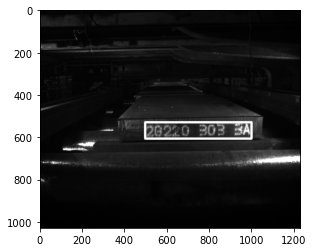

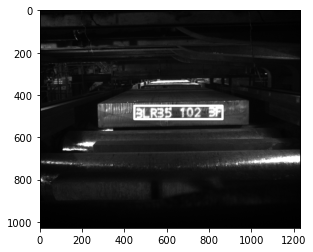

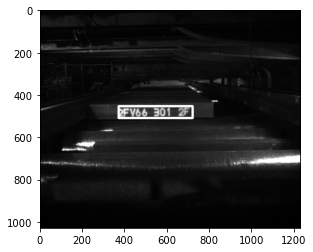

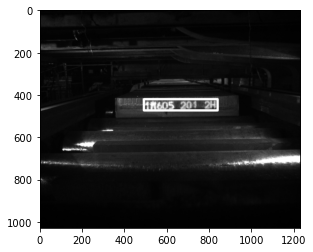

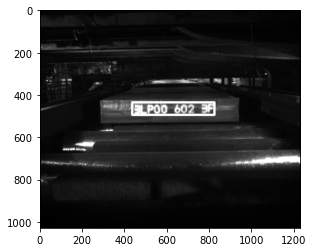

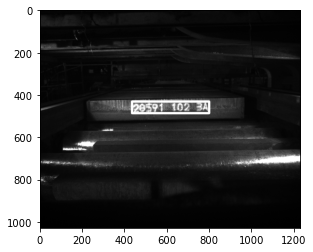

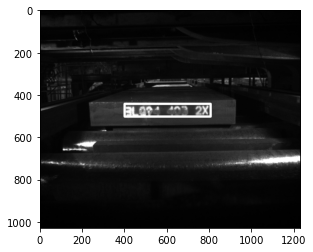

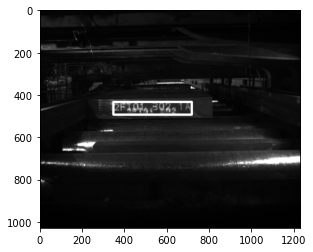

TRAIN GIOU loss: 0.13494 Focal: 0.13494
TRAIN GIOU loss: 0.12080 Focal: 0.12080
TRAIN GIOU loss: 0.12119 Focal: 0.12119
TRAIN GIOU loss: 0.11977 Focal: 0.11977
TRAIN GIOU loss: 0.11945 Focal: 0.11945
TRAIN GIOU loss: 0.11939 Focal: 0.11939
TRAIN GIOU loss: 0.11992 Focal: 0.11992
TRAIN GIOU loss: 0.11925 Focal: 0.11925
TRAIN GIOU loss: 0.12225 Focal: 0.12225
TRAIN GIOU loss: 0.12436 Focal: 0.12436
TRAIN GIOU loss: 0.12256 Focal: 0.12256
TRAIN GIOU loss: 0.12139 Focal: 0.12139
TRAIN GIOU loss: 0.12081 Focal: 0.12081
TRAIN GIOU loss: 0.12134 Focal: 0.12134
TRAIN GIOU loss: 0.12202 Focal: 0.12202
TRAIN GIOU loss: 0.12276 Focal: 0.12276
TRAIN GIOU loss: 0.12269 Focal: 0.12269
TRAIN GIOU loss: 0.12240 Focal: 0.12240
TRAIN GIOU loss: 0.12292 Focal: 0.12292
TRAIN GIOU loss: 0.12294 Focal: 0.12294
TRAIN GIOU loss: 0.12245 Focal: 0.12245
TRAIN GIOU loss: 0.12229 Focal: 0.12229
TRAIN GIOU loss: 0.12267 Focal: 0.12267
TRAIN GIOU loss: 0.12244 Focal: 0.12244
TRAIN GIOU loss: 0.12227 Focal: 0.12227


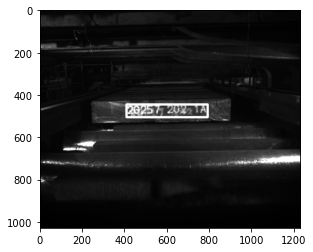

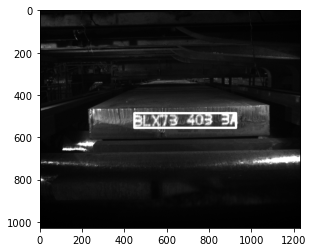

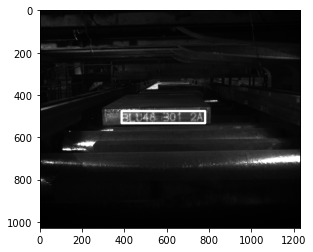

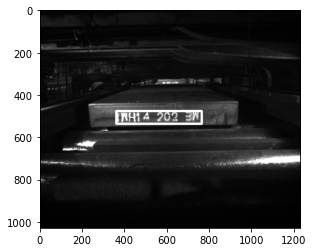

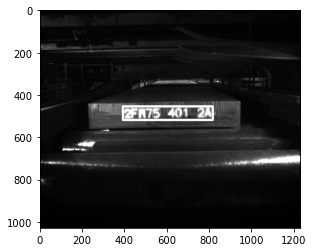

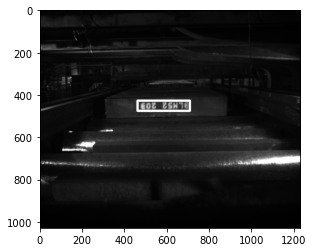

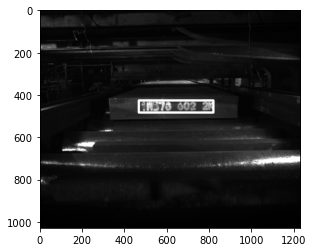

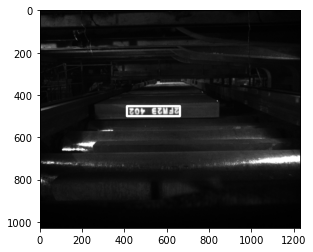

TRAIN GIOU loss: 0.10442 Focal: 0.10442
TRAIN GIOU loss: 0.11266 Focal: 0.11266
TRAIN GIOU loss: 0.10670 Focal: 0.10670
TRAIN GIOU loss: 0.10519 Focal: 0.10519
TRAIN GIOU loss: 0.10813 Focal: 0.10813
TRAIN GIOU loss: 0.11114 Focal: 0.11114
TRAIN GIOU loss: 0.11064 Focal: 0.11064
TRAIN GIOU loss: 0.11203 Focal: 0.11203
TRAIN GIOU loss: 0.11409 Focal: 0.11409
TRAIN GIOU loss: 0.11462 Focal: 0.11462
TRAIN GIOU loss: 0.11414 Focal: 0.11414
TRAIN GIOU loss: 0.11375 Focal: 0.11375
TRAIN GIOU loss: 0.11357 Focal: 0.11357
TRAIN GIOU loss: 0.11436 Focal: 0.11436
TRAIN GIOU loss: 0.11413 Focal: 0.11413
TRAIN GIOU loss: 0.11418 Focal: 0.11418
TRAIN GIOU loss: 0.11530 Focal: 0.11530
TRAIN GIOU loss: 0.11519 Focal: 0.11519
TRAIN GIOU loss: 0.11566 Focal: 0.11566
TRAIN GIOU loss: 0.11501 Focal: 0.11501
TRAIN GIOU loss: 0.11524 Focal: 0.11524
TRAIN GIOU loss: 0.11518 Focal: 0.11518
TRAIN GIOU loss: 0.11497 Focal: 0.11497
TRAIN GIOU loss: 0.11487 Focal: 0.11487
TRAIN GIOU loss: 0.11445 Focal: 0.11445


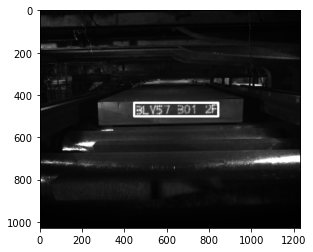

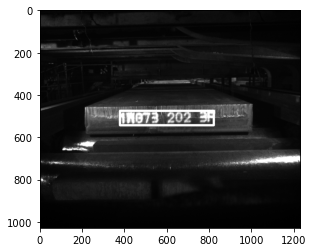

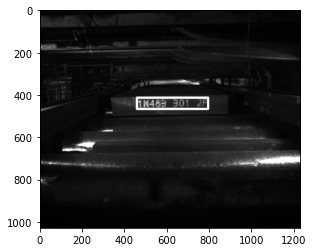

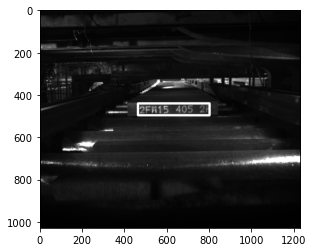

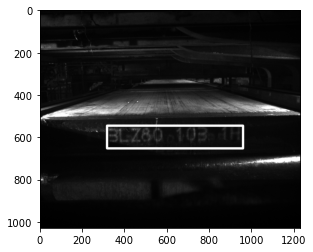

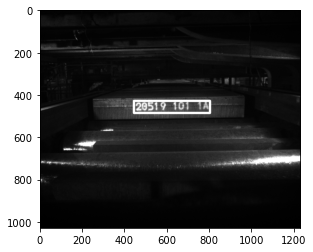

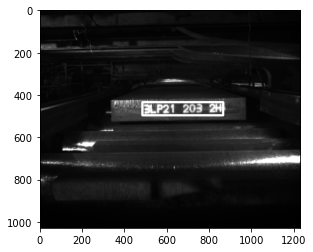

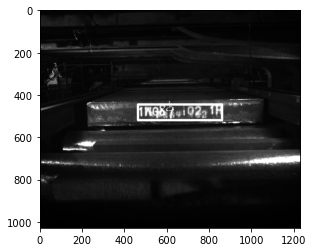

TRAIN GIOU loss: 0.10751 Focal: 0.10751
TRAIN GIOU loss: 0.11120 Focal: 0.11120
TRAIN GIOU loss: 0.10830 Focal: 0.10830
TRAIN GIOU loss: 0.11008 Focal: 0.11008
TRAIN GIOU loss: 0.10997 Focal: 0.10997
TRAIN GIOU loss: 0.10977 Focal: 0.10977
TRAIN GIOU loss: 0.10957 Focal: 0.10957
TRAIN GIOU loss: 0.10897 Focal: 0.10897
TRAIN GIOU loss: 0.10838 Focal: 0.10838
TRAIN GIOU loss: 0.10763 Focal: 0.10763
TRAIN GIOU loss: 0.10763 Focal: 0.10763
TRAIN GIOU loss: 0.10729 Focal: 0.10729
TRAIN GIOU loss: 0.10725 Focal: 0.10725
TRAIN GIOU loss: 0.10713 Focal: 0.10713
TRAIN GIOU loss: 0.10718 Focal: 0.10718
TRAIN GIOU loss: 0.10666 Focal: 0.10666
TRAIN GIOU loss: 0.10692 Focal: 0.10692
TRAIN GIOU loss: 0.10695 Focal: 0.10695
TRAIN GIOU loss: 0.10701 Focal: 0.10701
TRAIN GIOU loss: 0.10695 Focal: 0.10695
TRAIN GIOU loss: 0.10739 Focal: 0.10739
TRAIN GIOU loss: 0.10711 Focal: 0.10711
TRAIN GIOU loss: 0.10703 Focal: 0.10703
TRAIN GIOU loss: 0.10686 Focal: 0.10686
TRAIN GIOU loss: 0.10702 Focal: 0.10702


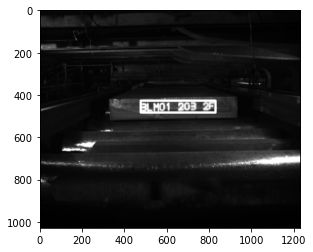

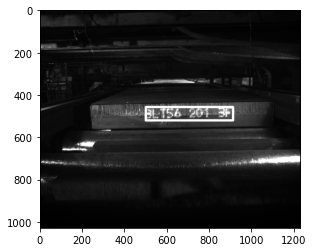

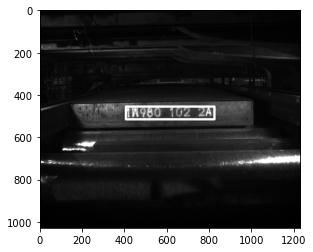

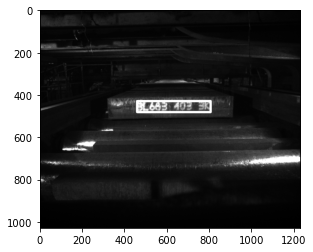

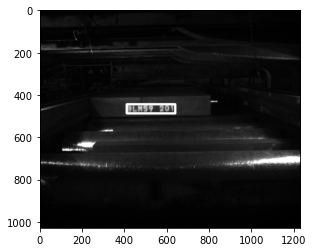

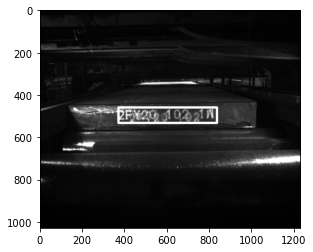

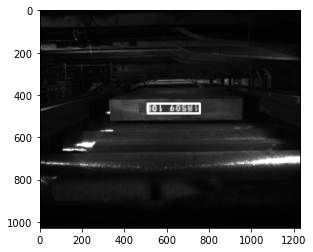

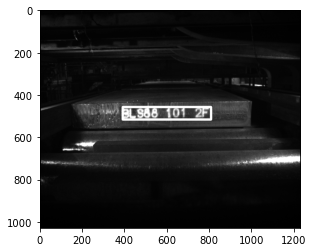

TRAIN GIOU loss: 0.10317 Focal: 0.10317
TRAIN GIOU loss: 0.11365 Focal: 0.11365
TRAIN GIOU loss: 0.11280 Focal: 0.11280
TRAIN GIOU loss: 0.11155 Focal: 0.11155
TRAIN GIOU loss: 0.11039 Focal: 0.11039
TRAIN GIOU loss: 0.11178 Focal: 0.11178
TRAIN GIOU loss: 0.11087 Focal: 0.11087
TRAIN GIOU loss: 0.11051 Focal: 0.11051
TRAIN GIOU loss: 0.10913 Focal: 0.10913
TRAIN GIOU loss: 0.10949 Focal: 0.10949
TRAIN GIOU loss: 0.10905 Focal: 0.10905
TRAIN GIOU loss: 0.11058 Focal: 0.11058
TRAIN GIOU loss: 0.11071 Focal: 0.11071
TRAIN GIOU loss: 0.11064 Focal: 0.11064
TRAIN GIOU loss: 0.11066 Focal: 0.11066
TRAIN GIOU loss: 0.11095 Focal: 0.11095
TRAIN GIOU loss: 0.11067 Focal: 0.11067
TRAIN GIOU loss: 0.10991 Focal: 0.10991
TRAIN GIOU loss: 0.11001 Focal: 0.11001
TRAIN GIOU loss: 0.10994 Focal: 0.10994
TRAIN GIOU loss: 0.10991 Focal: 0.10991
TRAIN GIOU loss: 0.10936 Focal: 0.10936
TRAIN GIOU loss: 0.10908 Focal: 0.10908
TRAIN GIOU loss: 0.10879 Focal: 0.10879
TRAIN GIOU loss: 0.10831 Focal: 0.10831


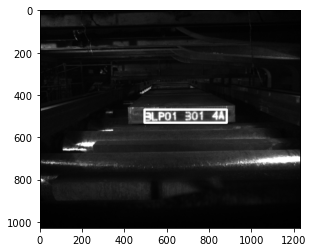

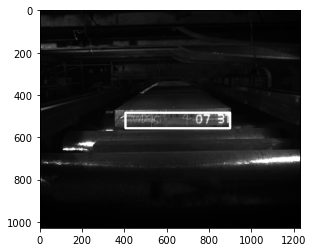

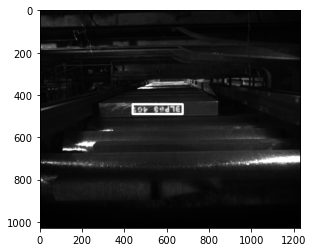

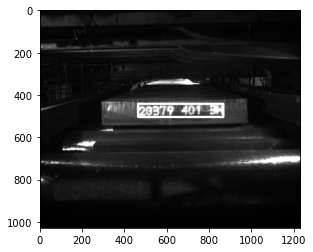

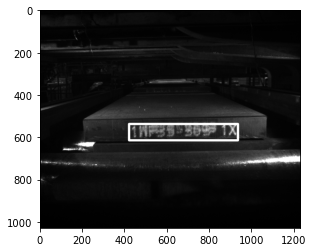

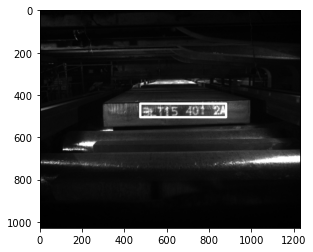

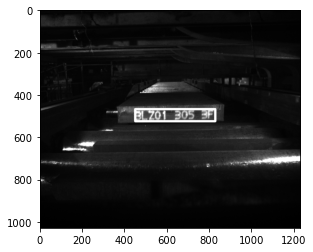

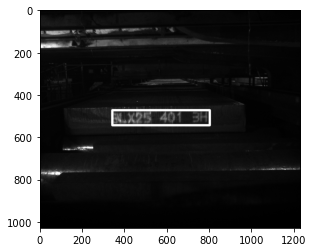

TRAIN GIOU loss: 0.10051 Focal: 0.10051
TRAIN GIOU loss: 0.10809 Focal: 0.10809
TRAIN GIOU loss: 0.10456 Focal: 0.10456
TRAIN GIOU loss: 0.10513 Focal: 0.10513
TRAIN GIOU loss: 0.10441 Focal: 0.10441
TRAIN GIOU loss: 0.10452 Focal: 0.10452
TRAIN GIOU loss: 0.10432 Focal: 0.10432
TRAIN GIOU loss: 0.10493 Focal: 0.10493
TRAIN GIOU loss: 0.10376 Focal: 0.10376
TRAIN GIOU loss: 0.10497 Focal: 0.10497
TRAIN GIOU loss: 0.10556 Focal: 0.10556
TRAIN GIOU loss: 0.10719 Focal: 0.10719
TRAIN GIOU loss: 0.10703 Focal: 0.10703
TRAIN GIOU loss: 0.10665 Focal: 0.10665
TRAIN GIOU loss: 0.10622 Focal: 0.10622
TRAIN GIOU loss: 0.10613 Focal: 0.10613
TRAIN GIOU loss: 0.10652 Focal: 0.10652
TRAIN GIOU loss: 0.10678 Focal: 0.10678
TRAIN GIOU loss: 0.10669 Focal: 0.10669
TRAIN GIOU loss: 0.10590 Focal: 0.10590
TRAIN GIOU loss: 0.10537 Focal: 0.10537
TRAIN GIOU loss: 0.10497 Focal: 0.10497
TRAIN GIOU loss: 0.10447 Focal: 0.10447
TRAIN GIOU loss: 0.10451 Focal: 0.10451
TRAIN GIOU loss: 0.10417 Focal: 0.10417


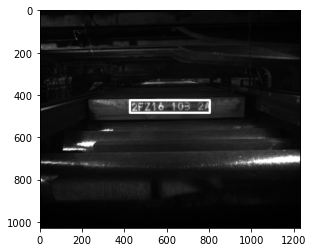

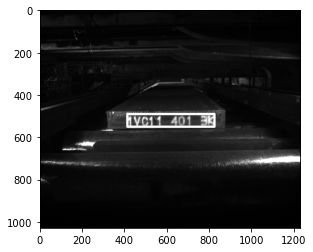

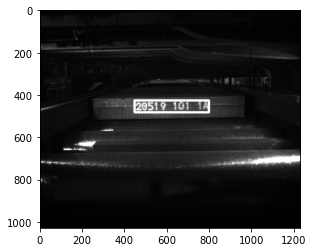

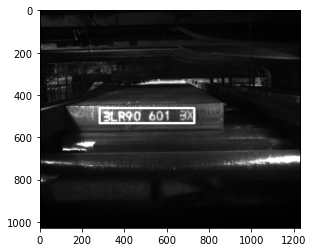

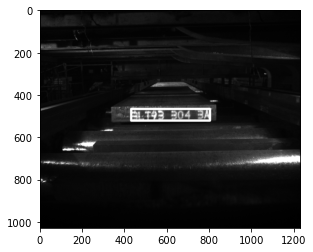

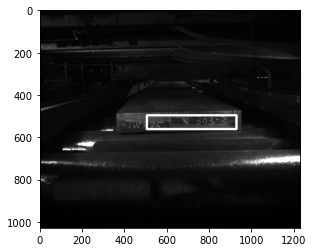

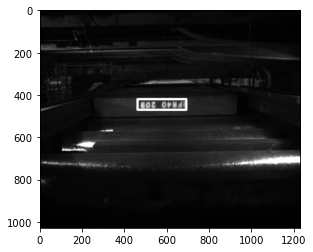

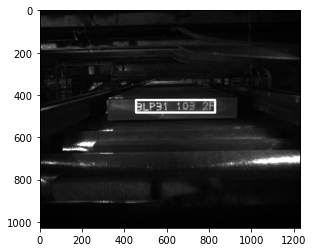

TRAIN GIOU loss: 0.09957 Focal: 0.09957
TRAIN GIOU loss: 0.10210 Focal: 0.10210
TRAIN GIOU loss: 0.09908 Focal: 0.09908
TRAIN GIOU loss: 0.10240 Focal: 0.10240
TRAIN GIOU loss: 0.10011 Focal: 0.10011
TRAIN GIOU loss: 0.10020 Focal: 0.10020
TRAIN GIOU loss: 0.10139 Focal: 0.10139
TRAIN GIOU loss: 0.10228 Focal: 0.10228
TRAIN GIOU loss: 0.10147 Focal: 0.10147
TRAIN GIOU loss: 0.10027 Focal: 0.10027
TRAIN GIOU loss: 0.10105 Focal: 0.10105
TRAIN GIOU loss: 0.10175 Focal: 0.10175
TRAIN GIOU loss: 0.10201 Focal: 0.10201
TRAIN GIOU loss: 0.10171 Focal: 0.10171
TRAIN GIOU loss: 0.10101 Focal: 0.10101
TRAIN GIOU loss: 0.10095 Focal: 0.10095
TRAIN GIOU loss: 0.10086 Focal: 0.10086
TRAIN GIOU loss: 0.10092 Focal: 0.10092
TRAIN GIOU loss: 0.10091 Focal: 0.10091
TRAIN GIOU loss: 0.10076 Focal: 0.10076
TRAIN GIOU loss: 0.10095 Focal: 0.10095
TRAIN GIOU loss: 0.10079 Focal: 0.10079
TRAIN GIOU loss: 0.10068 Focal: 0.10068
TRAIN GIOU loss: 0.10127 Focal: 0.10127
TRAIN GIOU loss: 0.10177 Focal: 0.10177


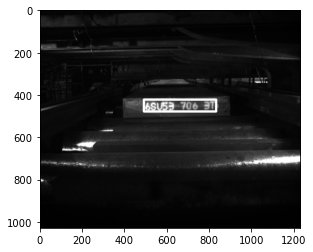

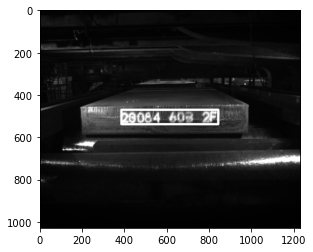

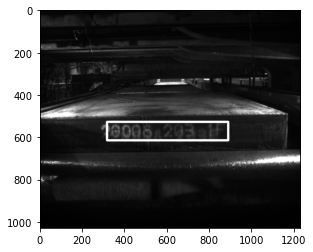

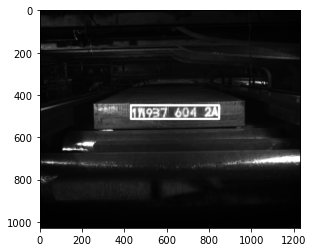

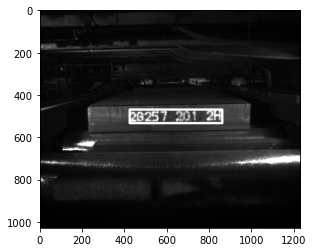

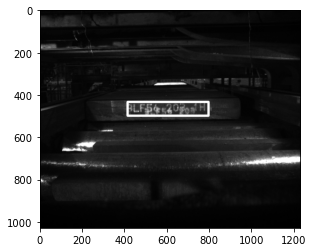

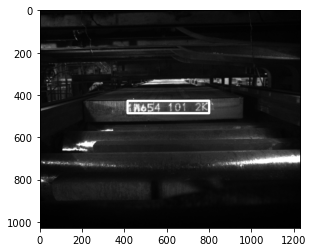

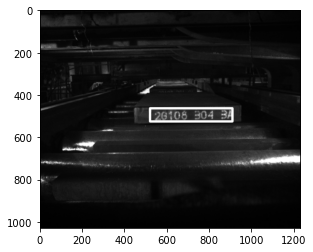

TRAIN GIOU loss: 0.11328 Focal: 0.11328
TRAIN GIOU loss: 0.11262 Focal: 0.11262
TRAIN GIOU loss: 0.10688 Focal: 0.10688
TRAIN GIOU loss: 0.10440 Focal: 0.10440
TRAIN GIOU loss: 0.10297 Focal: 0.10297
TRAIN GIOU loss: 0.10086 Focal: 0.10086
TRAIN GIOU loss: 0.10057 Focal: 0.10057
TRAIN GIOU loss: 0.10073 Focal: 0.10073
TRAIN GIOU loss: 0.10107 Focal: 0.10107
TRAIN GIOU loss: 0.10090 Focal: 0.10090
TRAIN GIOU loss: 0.10084 Focal: 0.10084
TRAIN GIOU loss: 0.10084 Focal: 0.10084
TRAIN GIOU loss: 0.10100 Focal: 0.10100
TRAIN GIOU loss: 0.10047 Focal: 0.10047
TRAIN GIOU loss: 0.09998 Focal: 0.09998
TRAIN GIOU loss: 0.10028 Focal: 0.10028
TRAIN GIOU loss: 0.09983 Focal: 0.09983
TRAIN GIOU loss: 0.09978 Focal: 0.09978
TRAIN GIOU loss: 0.10018 Focal: 0.10018
TRAIN GIOU loss: 0.09993 Focal: 0.09993
TRAIN GIOU loss: 0.09999 Focal: 0.09999
TRAIN GIOU loss: 0.10011 Focal: 0.10011
TRAIN GIOU loss: 0.10060 Focal: 0.10060
TRAIN GIOU loss: 0.10049 Focal: 0.10049
TRAIN GIOU loss: 0.10063 Focal: 0.10063


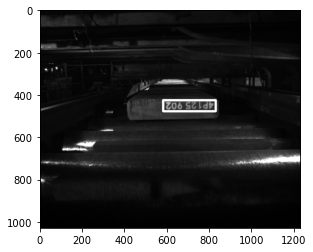

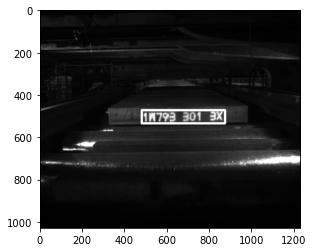

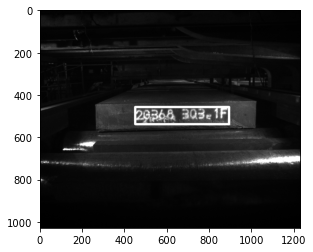

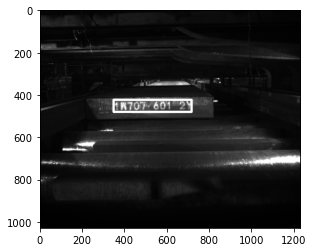

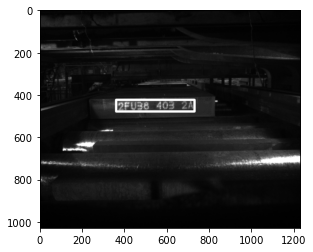

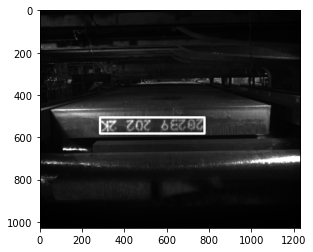

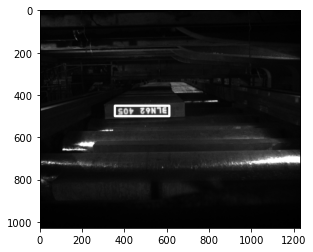

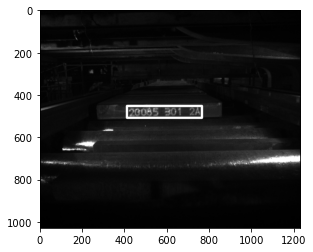

TRAIN GIOU loss: 0.09192 Focal: 0.09192
TRAIN GIOU loss: 0.10265 Focal: 0.10265
TRAIN GIOU loss: 0.10108 Focal: 0.10108
TRAIN GIOU loss: 0.10283 Focal: 0.10283
TRAIN GIOU loss: 0.09894 Focal: 0.09894
TRAIN GIOU loss: 0.09679 Focal: 0.09679
TRAIN GIOU loss: 0.09787 Focal: 0.09787
TRAIN GIOU loss: 0.09814 Focal: 0.09814
TRAIN GIOU loss: 0.10042 Focal: 0.10042
TRAIN GIOU loss: 0.10019 Focal: 0.10019
TRAIN GIOU loss: 0.10068 Focal: 0.10068
TRAIN GIOU loss: 0.10067 Focal: 0.10067
TRAIN GIOU loss: 0.10007 Focal: 0.10007
TRAIN GIOU loss: 0.10009 Focal: 0.10009
TRAIN GIOU loss: 0.09906 Focal: 0.09906
TRAIN GIOU loss: 0.09775 Focal: 0.09775
TRAIN GIOU loss: 0.09773 Focal: 0.09773
TRAIN GIOU loss: 0.09736 Focal: 0.09736
TRAIN GIOU loss: 0.09727 Focal: 0.09727
TRAIN GIOU loss: 0.09737 Focal: 0.09737
TRAIN GIOU loss: 0.09721 Focal: 0.09721
TRAIN GIOU loss: 0.09696 Focal: 0.09696
TRAIN GIOU loss: 0.09675 Focal: 0.09675
TRAIN GIOU loss: 0.09677 Focal: 0.09677
TRAIN GIOU loss: 0.09684 Focal: 0.09684


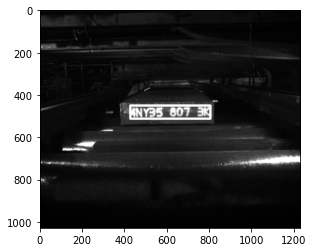

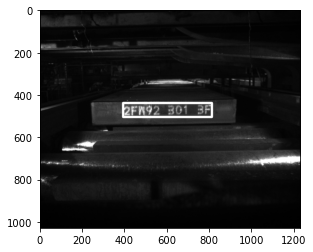

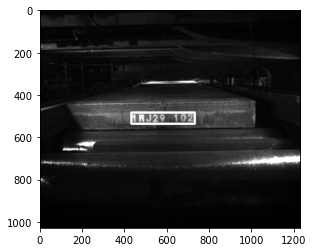

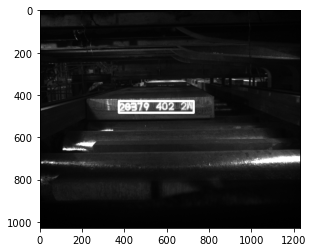

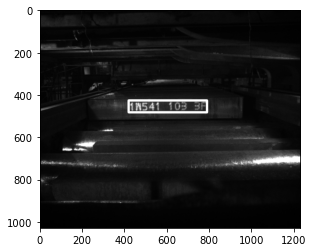

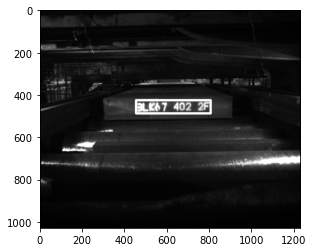

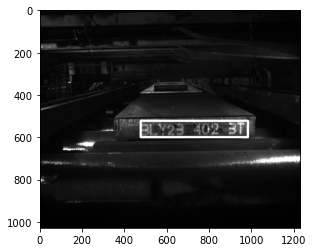

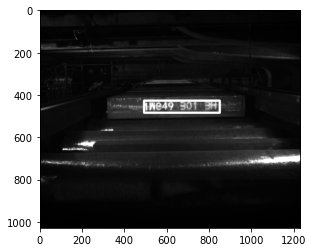

TRAIN GIOU loss: 0.08320 Focal: 0.08320
TRAIN GIOU loss: 0.09124 Focal: 0.09124
TRAIN GIOU loss: 0.08998 Focal: 0.08998
TRAIN GIOU loss: 0.09253 Focal: 0.09253
TRAIN GIOU loss: 0.09248 Focal: 0.09248
TRAIN GIOU loss: 0.09141 Focal: 0.09141
TRAIN GIOU loss: 0.09281 Focal: 0.09281
TRAIN GIOU loss: 0.09197 Focal: 0.09197
TRAIN GIOU loss: 0.09118 Focal: 0.09118
TRAIN GIOU loss: 0.09193 Focal: 0.09193
TRAIN GIOU loss: 0.09310 Focal: 0.09310
TRAIN GIOU loss: 0.09301 Focal: 0.09301
TRAIN GIOU loss: 0.09337 Focal: 0.09337
TRAIN GIOU loss: 0.09297 Focal: 0.09297
TRAIN GIOU loss: 0.09267 Focal: 0.09267
TRAIN GIOU loss: 0.09294 Focal: 0.09294
TRAIN GIOU loss: 0.09303 Focal: 0.09303
TRAIN GIOU loss: 0.09292 Focal: 0.09292
TRAIN GIOU loss: 0.09305 Focal: 0.09305
TRAIN GIOU loss: 0.09310 Focal: 0.09310
TRAIN GIOU loss: 0.09326 Focal: 0.09326
TRAIN GIOU loss: 0.09314 Focal: 0.09314
TRAIN GIOU loss: 0.09309 Focal: 0.09309
TRAIN GIOU loss: 0.09309 Focal: 0.09309
TRAIN GIOU loss: 0.09300 Focal: 0.09300


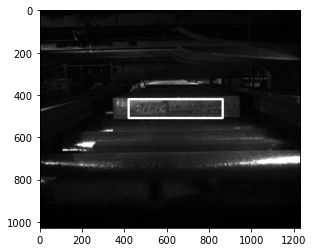

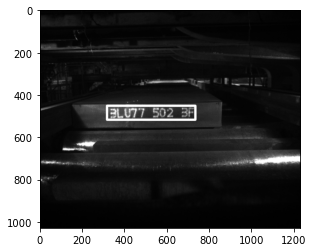

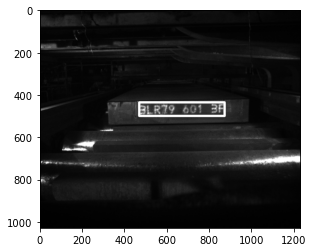

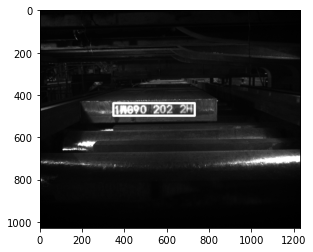

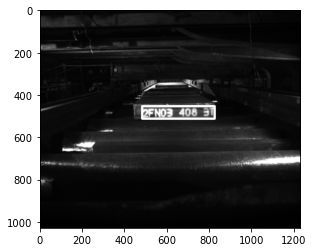

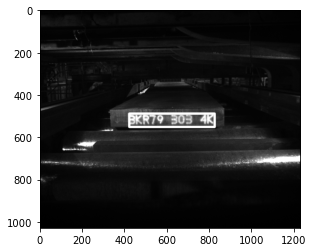

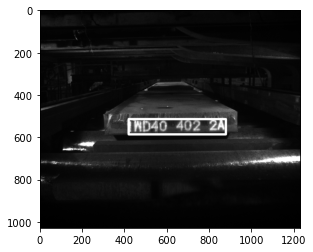

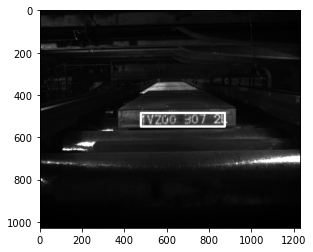

TRAIN GIOU loss: 0.08651 Focal: 0.08651
TRAIN GIOU loss: 0.08723 Focal: 0.08723
TRAIN GIOU loss: 0.08725 Focal: 0.08725
TRAIN GIOU loss: 0.09146 Focal: 0.09146
TRAIN GIOU loss: 0.09001 Focal: 0.09001
TRAIN GIOU loss: 0.09319 Focal: 0.09319
TRAIN GIOU loss: 0.09419 Focal: 0.09419
TRAIN GIOU loss: 0.09414 Focal: 0.09414
TRAIN GIOU loss: 0.09349 Focal: 0.09349
TRAIN GIOU loss: 0.09319 Focal: 0.09319
TRAIN GIOU loss: 0.09235 Focal: 0.09235
TRAIN GIOU loss: 0.09322 Focal: 0.09322
TRAIN GIOU loss: 0.09349 Focal: 0.09349
TRAIN GIOU loss: 0.09317 Focal: 0.09317
TRAIN GIOU loss: 0.09354 Focal: 0.09354
TRAIN GIOU loss: 0.09349 Focal: 0.09349
TRAIN GIOU loss: 0.09388 Focal: 0.09388
TRAIN GIOU loss: 0.09405 Focal: 0.09405
TRAIN GIOU loss: 0.09411 Focal: 0.09411
TRAIN GIOU loss: 0.09364 Focal: 0.09364
TRAIN GIOU loss: 0.09289 Focal: 0.09289
TRAIN GIOU loss: 0.09293 Focal: 0.09293
TRAIN GIOU loss: 0.09285 Focal: 0.09285
TRAIN GIOU loss: 0.09270 Focal: 0.09270
TRAIN GIOU loss: 0.09268 Focal: 0.09268


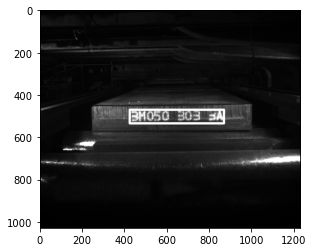

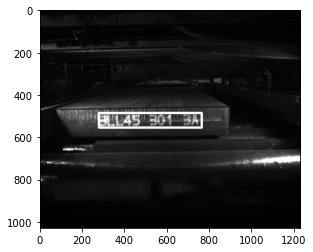

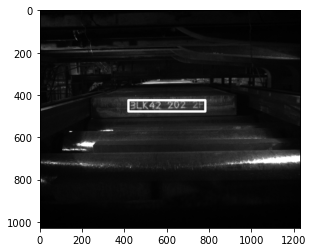

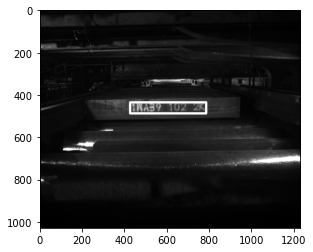

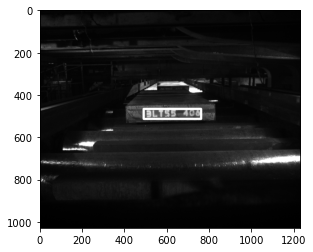

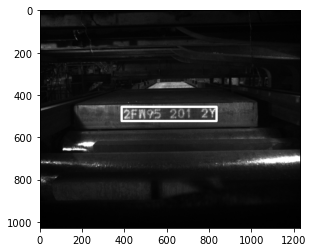

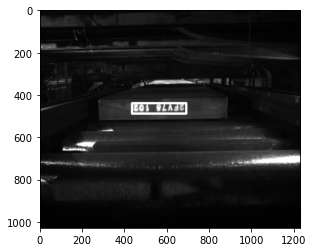

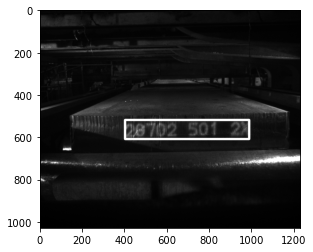

TRAIN GIOU loss: 0.08727 Focal: 0.08727
TRAIN GIOU loss: 0.09378 Focal: 0.09378
TRAIN GIOU loss: 0.09488 Focal: 0.09488
TRAIN GIOU loss: 0.09381 Focal: 0.09381
TRAIN GIOU loss: 0.09296 Focal: 0.09296
TRAIN GIOU loss: 0.09056 Focal: 0.09056
TRAIN GIOU loss: 0.09061 Focal: 0.09061
TRAIN GIOU loss: 0.08989 Focal: 0.08989
TRAIN GIOU loss: 0.08995 Focal: 0.08995
TRAIN GIOU loss: 0.09045 Focal: 0.09045
TRAIN GIOU loss: 0.09008 Focal: 0.09008
TRAIN GIOU loss: 0.08976 Focal: 0.08976
TRAIN GIOU loss: 0.09000 Focal: 0.09000
TRAIN GIOU loss: 0.09058 Focal: 0.09058
TRAIN GIOU loss: 0.09114 Focal: 0.09114
TRAIN GIOU loss: 0.09151 Focal: 0.09151
TRAIN GIOU loss: 0.09155 Focal: 0.09155
TRAIN GIOU loss: 0.09152 Focal: 0.09152
TRAIN GIOU loss: 0.09129 Focal: 0.09129
TRAIN GIOU loss: 0.09117 Focal: 0.09117
TRAIN GIOU loss: 0.09118 Focal: 0.09118
TRAIN GIOU loss: 0.09083 Focal: 0.09083
TRAIN GIOU loss: 0.09054 Focal: 0.09054
TRAIN GIOU loss: 0.09048 Focal: 0.09048
TRAIN GIOU loss: 0.09034 Focal: 0.09034


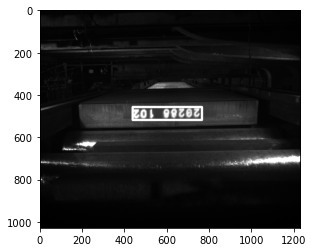

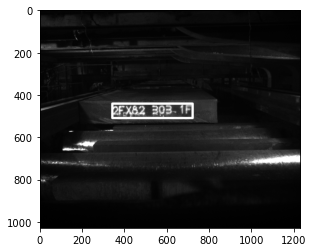

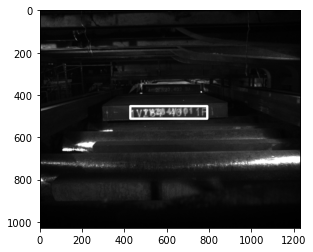

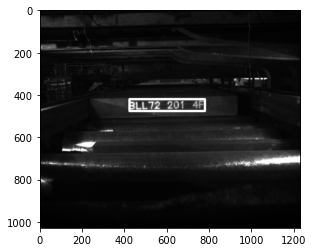

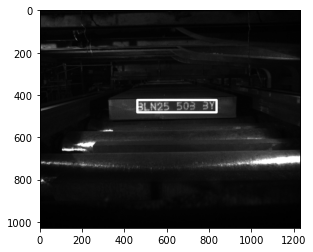

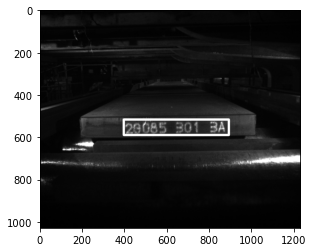

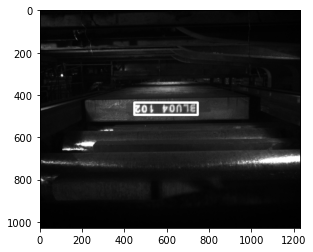

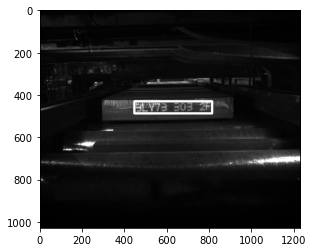

TRAIN GIOU loss: 0.09516 Focal: 0.09516
TRAIN GIOU loss: 0.08954 Focal: 0.08954
TRAIN GIOU loss: 0.08896 Focal: 0.08896
TRAIN GIOU loss: 0.08905 Focal: 0.08905
TRAIN GIOU loss: 0.08836 Focal: 0.08836
TRAIN GIOU loss: 0.08755 Focal: 0.08755
TRAIN GIOU loss: 0.08843 Focal: 0.08843
TRAIN GIOU loss: 0.08799 Focal: 0.08799
TRAIN GIOU loss: 0.08841 Focal: 0.08841
TRAIN GIOU loss: 0.08849 Focal: 0.08849
TRAIN GIOU loss: 0.08842 Focal: 0.08842
TRAIN GIOU loss: 0.08814 Focal: 0.08814
TRAIN GIOU loss: 0.08851 Focal: 0.08851
TRAIN GIOU loss: 0.08850 Focal: 0.08850
TRAIN GIOU loss: 0.08885 Focal: 0.08885
TRAIN GIOU loss: 0.08856 Focal: 0.08856
TRAIN GIOU loss: 0.08864 Focal: 0.08864
TRAIN GIOU loss: 0.08880 Focal: 0.08880
TRAIN GIOU loss: 0.08856 Focal: 0.08856
TRAIN GIOU loss: 0.08932 Focal: 0.08932
TRAIN GIOU loss: 0.08950 Focal: 0.08950
TRAIN GIOU loss: 0.08960 Focal: 0.08960
TRAIN GIOU loss: 0.08931 Focal: 0.08931
TRAIN GIOU loss: 0.08891 Focal: 0.08891
TRAIN GIOU loss: 0.08939 Focal: 0.08939


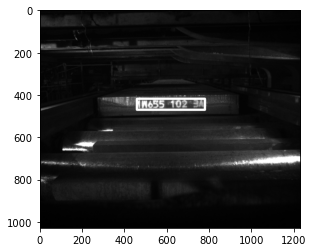

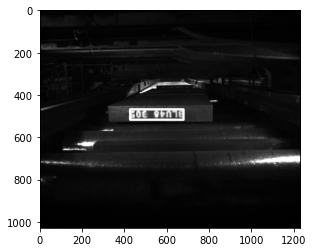

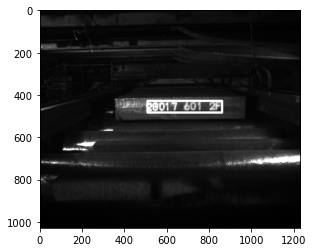

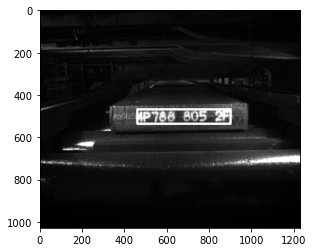

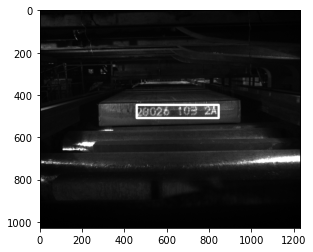

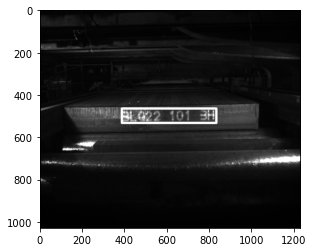

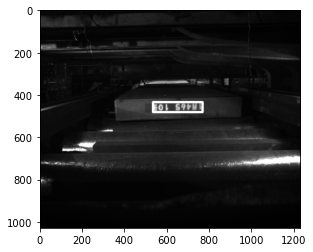

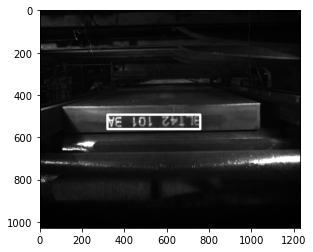

TRAIN GIOU loss: 0.09115 Focal: 0.09115
TRAIN GIOU loss: 0.08742 Focal: 0.08742
TRAIN GIOU loss: 0.08668 Focal: 0.08668
TRAIN GIOU loss: 0.08608 Focal: 0.08608
TRAIN GIOU loss: 0.08595 Focal: 0.08595
TRAIN GIOU loss: 0.08705 Focal: 0.08705
TRAIN GIOU loss: 0.08805 Focal: 0.08805
TRAIN GIOU loss: 0.08726 Focal: 0.08726
TRAIN GIOU loss: 0.08645 Focal: 0.08645
TRAIN GIOU loss: 0.08626 Focal: 0.08626
TRAIN GIOU loss: 0.08667 Focal: 0.08667
TRAIN GIOU loss: 0.08693 Focal: 0.08693
TRAIN GIOU loss: 0.08755 Focal: 0.08755
TRAIN GIOU loss: 0.08773 Focal: 0.08773
TRAIN GIOU loss: 0.08849 Focal: 0.08849
TRAIN GIOU loss: 0.08901 Focal: 0.08901
TRAIN GIOU loss: 0.08866 Focal: 0.08866
TRAIN GIOU loss: 0.08842 Focal: 0.08842
TRAIN GIOU loss: 0.08859 Focal: 0.08859
TRAIN GIOU loss: 0.08838 Focal: 0.08838
TRAIN GIOU loss: 0.08840 Focal: 0.08840
TRAIN GIOU loss: 0.08823 Focal: 0.08823
TRAIN GIOU loss: 0.08845 Focal: 0.08845
TRAIN GIOU loss: 0.08888 Focal: 0.08888
TRAIN GIOU loss: 0.08859 Focal: 0.08859


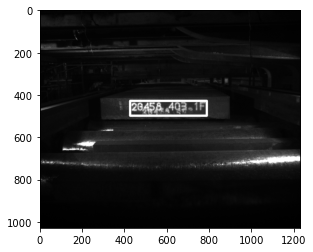

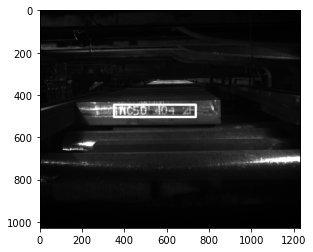

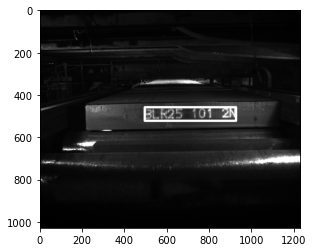

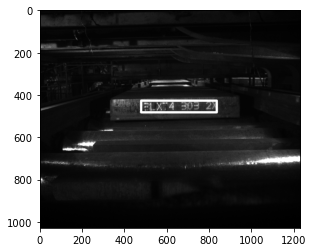

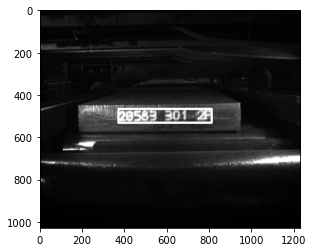

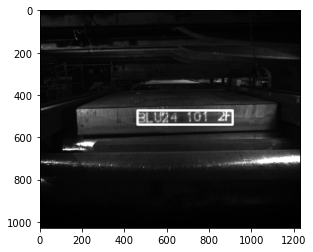

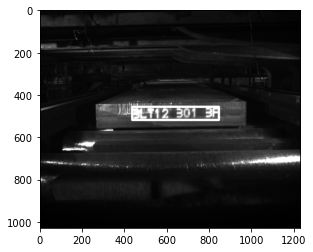

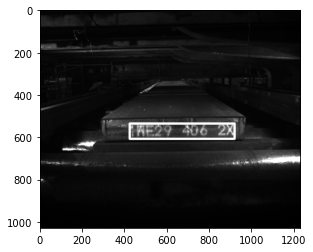

TRAIN GIOU loss: 0.07373 Focal: 0.07373
TRAIN GIOU loss: 0.07853 Focal: 0.07853
TRAIN GIOU loss: 0.08195 Focal: 0.08195
TRAIN GIOU loss: 0.08643 Focal: 0.08643
TRAIN GIOU loss: 0.08644 Focal: 0.08644
TRAIN GIOU loss: 0.08792 Focal: 0.08792
TRAIN GIOU loss: 0.08678 Focal: 0.08678
TRAIN GIOU loss: 0.08641 Focal: 0.08641
TRAIN GIOU loss: 0.08717 Focal: 0.08717
TRAIN GIOU loss: 0.08770 Focal: 0.08770
TRAIN GIOU loss: 0.08689 Focal: 0.08689
TRAIN GIOU loss: 0.08607 Focal: 0.08607
TRAIN GIOU loss: 0.08565 Focal: 0.08565
TRAIN GIOU loss: 0.08552 Focal: 0.08552
TRAIN GIOU loss: 0.08564 Focal: 0.08564
TRAIN GIOU loss: 0.08600 Focal: 0.08600
TRAIN GIOU loss: 0.08582 Focal: 0.08582
TRAIN GIOU loss: 0.08572 Focal: 0.08572
TRAIN GIOU loss: 0.08555 Focal: 0.08555
TRAIN GIOU loss: 0.08576 Focal: 0.08576
TRAIN GIOU loss: 0.08636 Focal: 0.08636
TRAIN GIOU loss: 0.08641 Focal: 0.08641
TRAIN GIOU loss: 0.08632 Focal: 0.08632
TRAIN GIOU loss: 0.08636 Focal: 0.08636
TRAIN GIOU loss: 0.08674 Focal: 0.08674


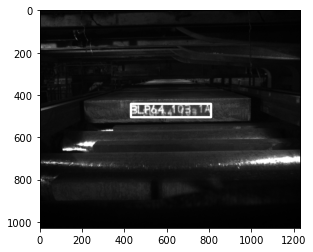

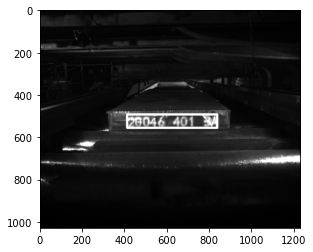

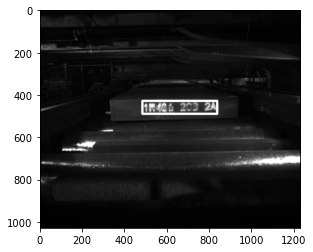

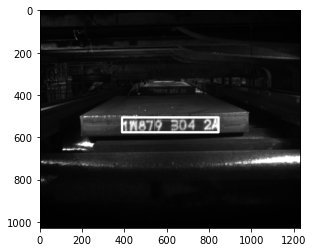

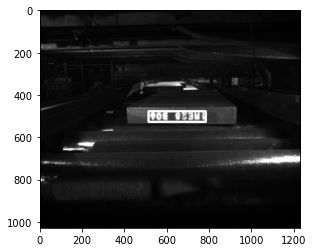

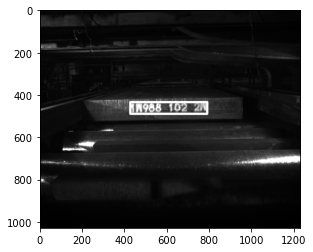

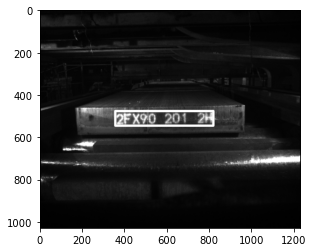

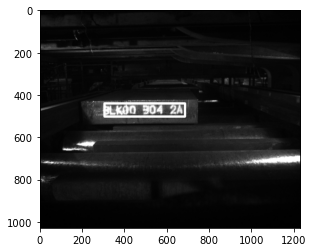

TRAIN GIOU loss: 0.10352 Focal: 0.10352
TRAIN GIOU loss: 0.09468 Focal: 0.09468
TRAIN GIOU loss: 0.09070 Focal: 0.09070
TRAIN GIOU loss: 0.08684 Focal: 0.08684
TRAIN GIOU loss: 0.08610 Focal: 0.08610
TRAIN GIOU loss: 0.08671 Focal: 0.08671
TRAIN GIOU loss: 0.08653 Focal: 0.08653
TRAIN GIOU loss: 0.08652 Focal: 0.08652
TRAIN GIOU loss: 0.08610 Focal: 0.08610
TRAIN GIOU loss: 0.08599 Focal: 0.08599
TRAIN GIOU loss: 0.08639 Focal: 0.08639
TRAIN GIOU loss: 0.08537 Focal: 0.08537
TRAIN GIOU loss: 0.08603 Focal: 0.08603
TRAIN GIOU loss: 0.08559 Focal: 0.08559
TRAIN GIOU loss: 0.08525 Focal: 0.08525
TRAIN GIOU loss: 0.08534 Focal: 0.08534
TRAIN GIOU loss: 0.08503 Focal: 0.08503
TRAIN GIOU loss: 0.08536 Focal: 0.08536
TRAIN GIOU loss: 0.08547 Focal: 0.08547
TRAIN GIOU loss: 0.08564 Focal: 0.08564
TRAIN GIOU loss: 0.08579 Focal: 0.08579
TRAIN GIOU loss: 0.08628 Focal: 0.08628
TRAIN GIOU loss: 0.08613 Focal: 0.08613
TRAIN GIOU loss: 0.08584 Focal: 0.08584
TRAIN GIOU loss: 0.08583 Focal: 0.08583


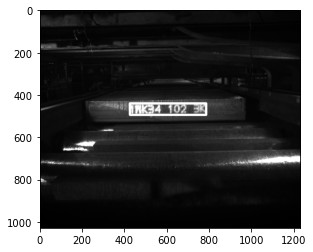

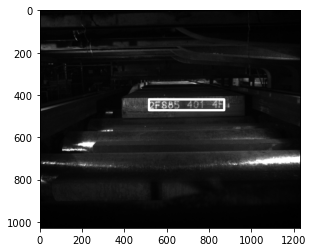

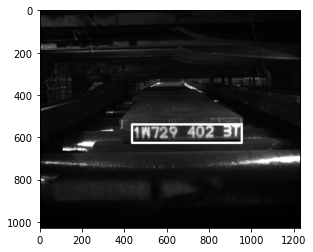

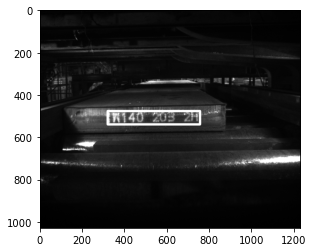

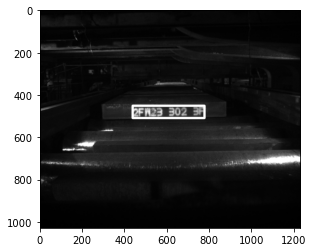

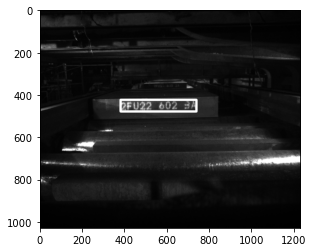

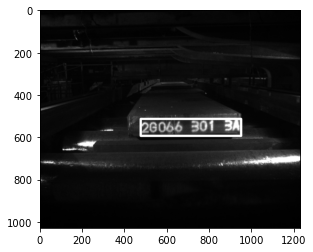

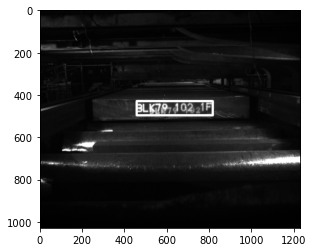

TRAIN GIOU loss: 0.08116 Focal: 0.08116
TRAIN GIOU loss: 0.07861 Focal: 0.07861
TRAIN GIOU loss: 0.07883 Focal: 0.07883
TRAIN GIOU loss: 0.08073 Focal: 0.08073
TRAIN GIOU loss: 0.08218 Focal: 0.08218
TRAIN GIOU loss: 0.08211 Focal: 0.08211
TRAIN GIOU loss: 0.08296 Focal: 0.08296
TRAIN GIOU loss: 0.08156 Focal: 0.08156
TRAIN GIOU loss: 0.08206 Focal: 0.08206
TRAIN GIOU loss: 0.08235 Focal: 0.08235
TRAIN GIOU loss: 0.08235 Focal: 0.08235
TRAIN GIOU loss: 0.08273 Focal: 0.08273
TRAIN GIOU loss: 0.08328 Focal: 0.08328
TRAIN GIOU loss: 0.08311 Focal: 0.08311
TRAIN GIOU loss: 0.08325 Focal: 0.08325
TRAIN GIOU loss: 0.08396 Focal: 0.08396
TRAIN GIOU loss: 0.08427 Focal: 0.08427
TRAIN GIOU loss: 0.08501 Focal: 0.08501
TRAIN GIOU loss: 0.08508 Focal: 0.08508
TRAIN GIOU loss: 0.08523 Focal: 0.08523
TRAIN GIOU loss: 0.08510 Focal: 0.08510
TRAIN GIOU loss: 0.08518 Focal: 0.08518
TRAIN GIOU loss: 0.08551 Focal: 0.08551
TRAIN GIOU loss: 0.08515 Focal: 0.08515
TRAIN GIOU loss: 0.08496 Focal: 0.08496


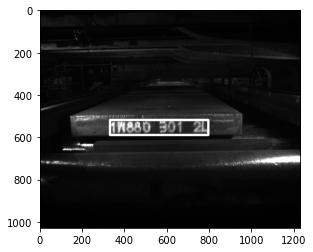

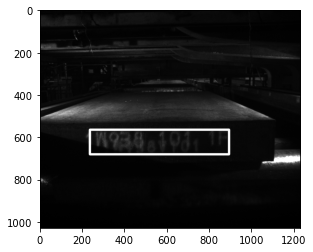

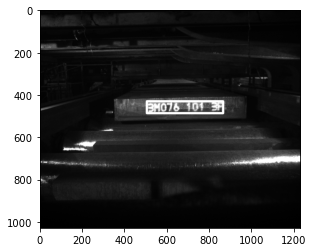

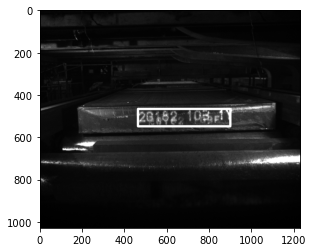

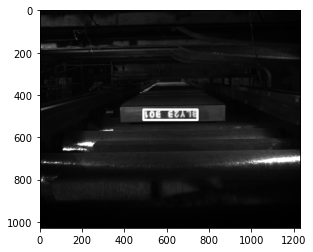

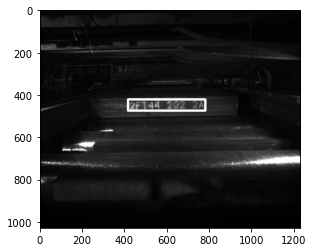

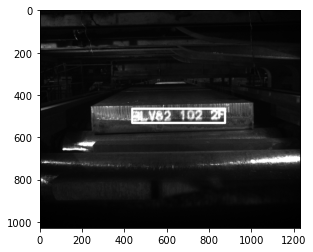

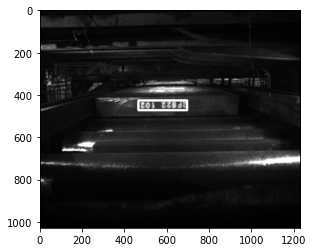

TRAIN GIOU loss: 0.09468 Focal: 0.09468
TRAIN GIOU loss: 0.08031 Focal: 0.08031
TRAIN GIOU loss: 0.08145 Focal: 0.08145
TRAIN GIOU loss: 0.08015 Focal: 0.08015
TRAIN GIOU loss: 0.07818 Focal: 0.07818
TRAIN GIOU loss: 0.07816 Focal: 0.07816
TRAIN GIOU loss: 0.07911 Focal: 0.07911
TRAIN GIOU loss: 0.07927 Focal: 0.07927
TRAIN GIOU loss: 0.07919 Focal: 0.07919
TRAIN GIOU loss: 0.07985 Focal: 0.07985
TRAIN GIOU loss: 0.08047 Focal: 0.08047
TRAIN GIOU loss: 0.08006 Focal: 0.08006
TRAIN GIOU loss: 0.08037 Focal: 0.08037
TRAIN GIOU loss: 0.08098 Focal: 0.08098
TRAIN GIOU loss: 0.08151 Focal: 0.08151
TRAIN GIOU loss: 0.08136 Focal: 0.08136
TRAIN GIOU loss: 0.08166 Focal: 0.08166
TRAIN GIOU loss: 0.08138 Focal: 0.08138
TRAIN GIOU loss: 0.08159 Focal: 0.08159
TRAIN GIOU loss: 0.08151 Focal: 0.08151
TRAIN GIOU loss: 0.08193 Focal: 0.08193
TRAIN GIOU loss: 0.08220 Focal: 0.08220
TRAIN GIOU loss: 0.08255 Focal: 0.08255
TRAIN GIOU loss: 0.08228 Focal: 0.08228
TRAIN GIOU loss: 0.08249 Focal: 0.08249


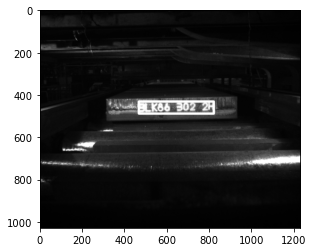

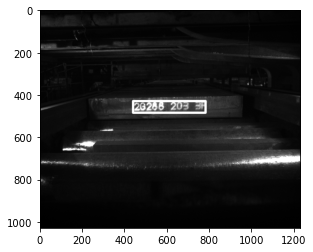

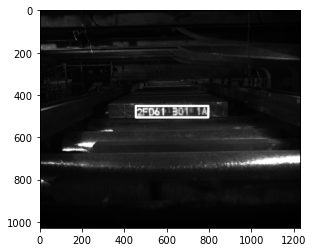

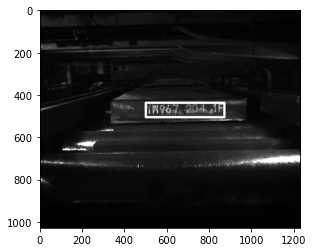

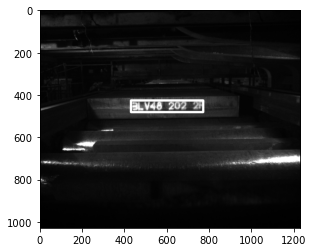

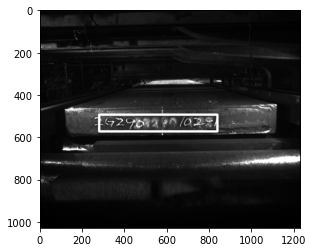

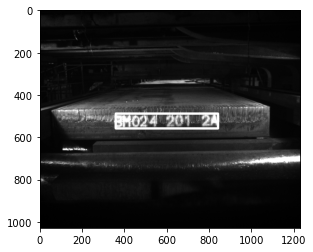

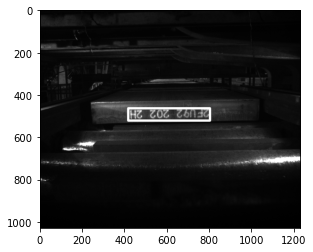

TRAIN GIOU loss: 0.08345 Focal: 0.08345
TRAIN GIOU loss: 0.09458 Focal: 0.09458
TRAIN GIOU loss: 0.08786 Focal: 0.08786
TRAIN GIOU loss: 0.08322 Focal: 0.08322
TRAIN GIOU loss: 0.08370 Focal: 0.08370
TRAIN GIOU loss: 0.08358 Focal: 0.08358
TRAIN GIOU loss: 0.08453 Focal: 0.08453
TRAIN GIOU loss: 0.08421 Focal: 0.08421
TRAIN GIOU loss: 0.08360 Focal: 0.08360
TRAIN GIOU loss: 0.08385 Focal: 0.08385
TRAIN GIOU loss: 0.08286 Focal: 0.08286
TRAIN GIOU loss: 0.08343 Focal: 0.08343
TRAIN GIOU loss: 0.08378 Focal: 0.08378
TRAIN GIOU loss: 0.08388 Focal: 0.08388
TRAIN GIOU loss: 0.08366 Focal: 0.08366
TRAIN GIOU loss: 0.08325 Focal: 0.08325
TRAIN GIOU loss: 0.08301 Focal: 0.08301
TRAIN GIOU loss: 0.08299 Focal: 0.08299
TRAIN GIOU loss: 0.08336 Focal: 0.08336
TRAIN GIOU loss: 0.08334 Focal: 0.08334
TRAIN GIOU loss: 0.08285 Focal: 0.08285
TRAIN GIOU loss: 0.08255 Focal: 0.08255
TRAIN GIOU loss: 0.08221 Focal: 0.08221
TRAIN GIOU loss: 0.08232 Focal: 0.08232
TRAIN GIOU loss: 0.08192 Focal: 0.08192


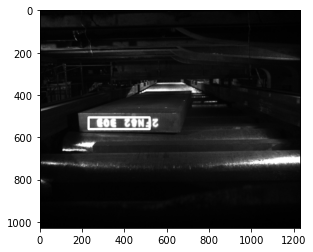

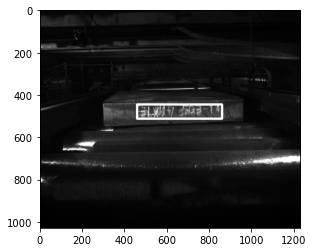

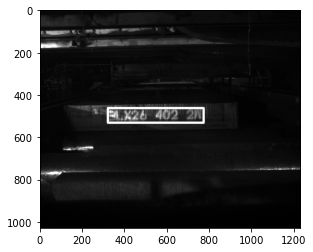

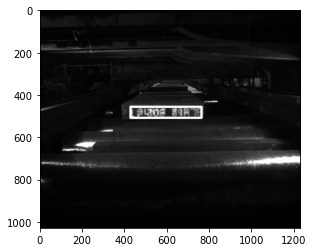

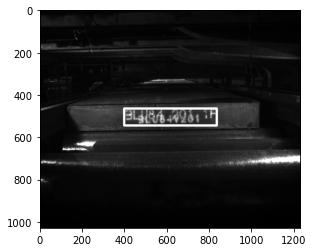

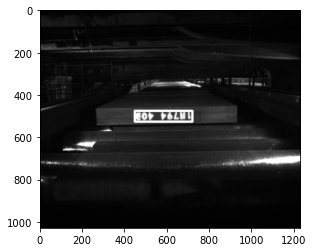

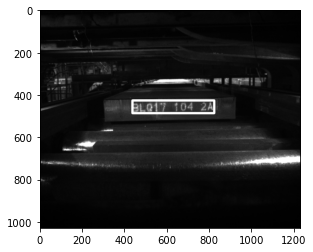

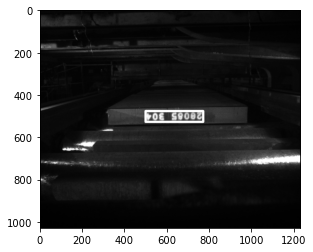

TRAIN GIOU loss: 0.07166 Focal: 0.07166
TRAIN GIOU loss: 0.07870 Focal: 0.07870
TRAIN GIOU loss: 0.08015 Focal: 0.08015
TRAIN GIOU loss: 0.08195 Focal: 0.08195
TRAIN GIOU loss: 0.08190 Focal: 0.08190
TRAIN GIOU loss: 0.08163 Focal: 0.08163
TRAIN GIOU loss: 0.08237 Focal: 0.08237
TRAIN GIOU loss: 0.08205 Focal: 0.08205
TRAIN GIOU loss: 0.08193 Focal: 0.08193
TRAIN GIOU loss: 0.08070 Focal: 0.08070
TRAIN GIOU loss: 0.08080 Focal: 0.08080
TRAIN GIOU loss: 0.08083 Focal: 0.08083
TRAIN GIOU loss: 0.08068 Focal: 0.08068
TRAIN GIOU loss: 0.08135 Focal: 0.08135
TRAIN GIOU loss: 0.08098 Focal: 0.08098
TRAIN GIOU loss: 0.08057 Focal: 0.08057
TRAIN GIOU loss: 0.08121 Focal: 0.08121
TRAIN GIOU loss: 0.08066 Focal: 0.08066
TRAIN GIOU loss: 0.08070 Focal: 0.08070
TRAIN GIOU loss: 0.08091 Focal: 0.08091
TRAIN GIOU loss: 0.08117 Focal: 0.08117
TRAIN GIOU loss: 0.08126 Focal: 0.08126
TRAIN GIOU loss: 0.08113 Focal: 0.08113
TRAIN GIOU loss: 0.08102 Focal: 0.08102
TRAIN GIOU loss: 0.08093 Focal: 0.08093


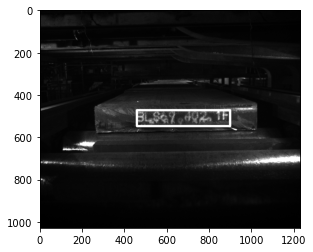

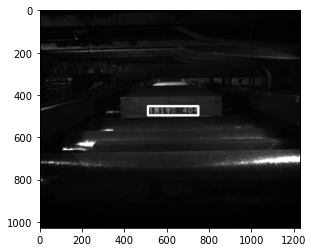

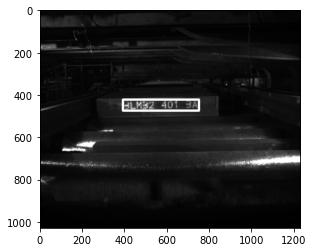

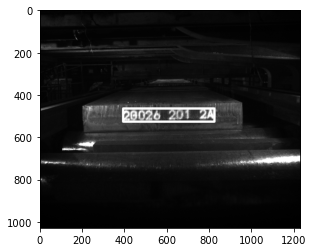

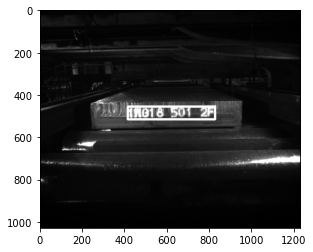

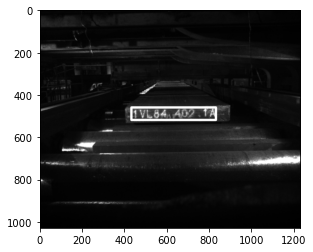

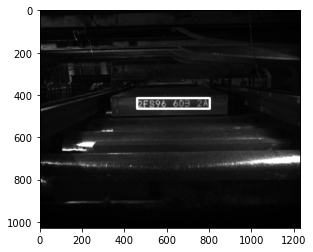

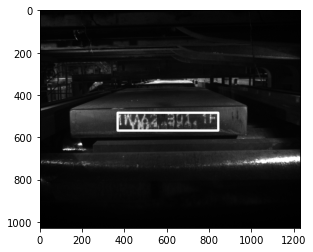

TRAIN GIOU loss: 0.07450 Focal: 0.07450
TRAIN GIOU loss: 0.07094 Focal: 0.07094
TRAIN GIOU loss: 0.07271 Focal: 0.07271
TRAIN GIOU loss: 0.07441 Focal: 0.07441
TRAIN GIOU loss: 0.07562 Focal: 0.07562
TRAIN GIOU loss: 0.07624 Focal: 0.07624
TRAIN GIOU loss: 0.07677 Focal: 0.07677
TRAIN GIOU loss: 0.07810 Focal: 0.07810
TRAIN GIOU loss: 0.07848 Focal: 0.07848
TRAIN GIOU loss: 0.07863 Focal: 0.07863
TRAIN GIOU loss: 0.07845 Focal: 0.07845
TRAIN GIOU loss: 0.07883 Focal: 0.07883
TRAIN GIOU loss: 0.07857 Focal: 0.07857
TRAIN GIOU loss: 0.07955 Focal: 0.07955
TRAIN GIOU loss: 0.07971 Focal: 0.07971
TRAIN GIOU loss: 0.07935 Focal: 0.07935
TRAIN GIOU loss: 0.07958 Focal: 0.07958
TRAIN GIOU loss: 0.07977 Focal: 0.07977
TRAIN GIOU loss: 0.07979 Focal: 0.07979
TRAIN GIOU loss: 0.07996 Focal: 0.07996
TRAIN GIOU loss: 0.07970 Focal: 0.07970
TRAIN GIOU loss: 0.07926 Focal: 0.07926
TRAIN GIOU loss: 0.07999 Focal: 0.07999
TRAIN GIOU loss: 0.07961 Focal: 0.07961
TRAIN GIOU loss: 0.07937 Focal: 0.07937


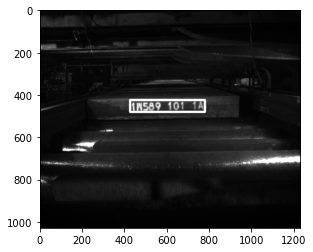

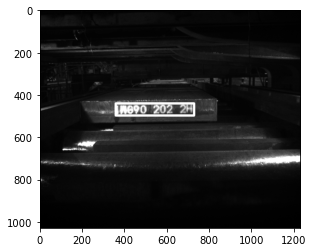

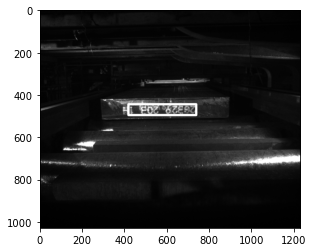

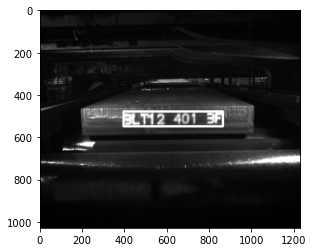

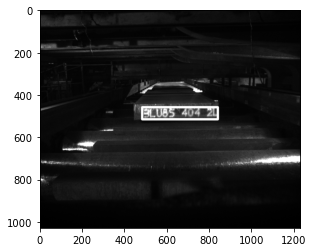

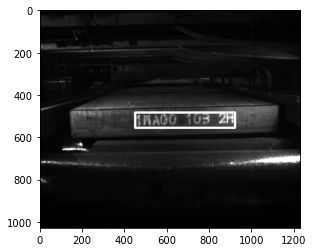

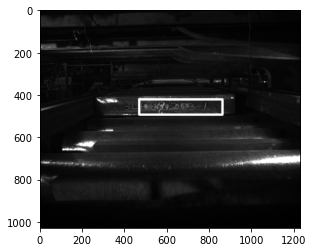

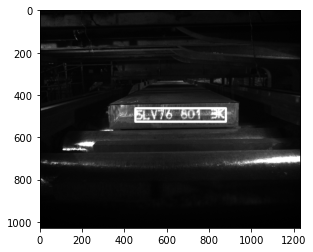

TRAIN GIOU loss: 0.05949 Focal: 0.05949
TRAIN GIOU loss: 0.06979 Focal: 0.06979
TRAIN GIOU loss: 0.06991 Focal: 0.06991
TRAIN GIOU loss: 0.07207 Focal: 0.07207
TRAIN GIOU loss: 0.07426 Focal: 0.07426
TRAIN GIOU loss: 0.07600 Focal: 0.07600
TRAIN GIOU loss: 0.07719 Focal: 0.07719
TRAIN GIOU loss: 0.07761 Focal: 0.07761
TRAIN GIOU loss: 0.07805 Focal: 0.07805
TRAIN GIOU loss: 0.07786 Focal: 0.07786
TRAIN GIOU loss: 0.07847 Focal: 0.07847
TRAIN GIOU loss: 0.07882 Focal: 0.07882
TRAIN GIOU loss: 0.07856 Focal: 0.07856
TRAIN GIOU loss: 0.07797 Focal: 0.07797
TRAIN GIOU loss: 0.07843 Focal: 0.07843
TRAIN GIOU loss: 0.07869 Focal: 0.07869
TRAIN GIOU loss: 0.07882 Focal: 0.07882
TRAIN GIOU loss: 0.07905 Focal: 0.07905
TRAIN GIOU loss: 0.07874 Focal: 0.07874
TRAIN GIOU loss: 0.07894 Focal: 0.07894
TRAIN GIOU loss: 0.07933 Focal: 0.07933
TRAIN GIOU loss: 0.07914 Focal: 0.07914
TRAIN GIOU loss: 0.07882 Focal: 0.07882
TRAIN GIOU loss: 0.07891 Focal: 0.07891
TRAIN GIOU loss: 0.07887 Focal: 0.07887


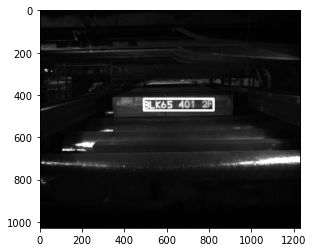

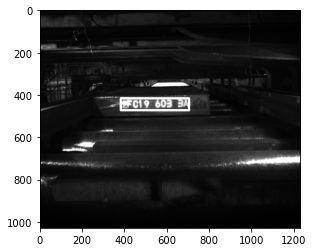

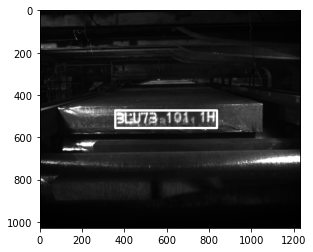

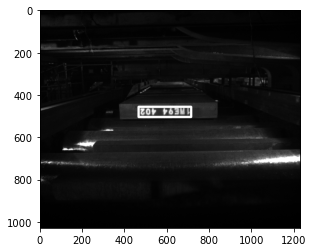

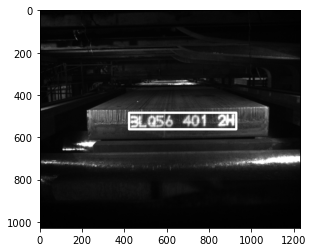

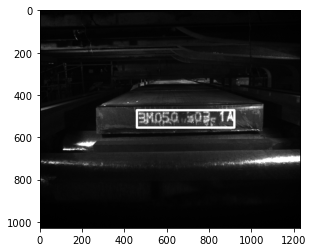

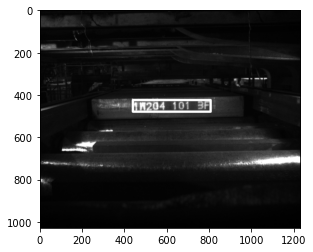

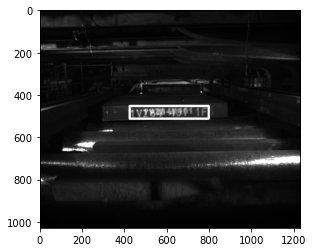

TRAIN GIOU loss: 0.08668 Focal: 0.08668
TRAIN GIOU loss: 0.08162 Focal: 0.08162
TRAIN GIOU loss: 0.08012 Focal: 0.08012
TRAIN GIOU loss: 0.08031 Focal: 0.08031
TRAIN GIOU loss: 0.07760 Focal: 0.07760
TRAIN GIOU loss: 0.07692 Focal: 0.07692
TRAIN GIOU loss: 0.07789 Focal: 0.07789
TRAIN GIOU loss: 0.07949 Focal: 0.07949
TRAIN GIOU loss: 0.07928 Focal: 0.07928
TRAIN GIOU loss: 0.07929 Focal: 0.07929
TRAIN GIOU loss: 0.07875 Focal: 0.07875
TRAIN GIOU loss: 0.07849 Focal: 0.07849
TRAIN GIOU loss: 0.07810 Focal: 0.07810
TRAIN GIOU loss: 0.07817 Focal: 0.07817
TRAIN GIOU loss: 0.07810 Focal: 0.07810
TRAIN GIOU loss: 0.07745 Focal: 0.07745
TRAIN GIOU loss: 0.07794 Focal: 0.07794
TRAIN GIOU loss: 0.07763 Focal: 0.07763
TRAIN GIOU loss: 0.07772 Focal: 0.07772
TRAIN GIOU loss: 0.07813 Focal: 0.07813
TRAIN GIOU loss: 0.07798 Focal: 0.07798
TRAIN GIOU loss: 0.07829 Focal: 0.07829
TRAIN GIOU loss: 0.07848 Focal: 0.07848
TRAIN GIOU loss: 0.07885 Focal: 0.07885
TRAIN GIOU loss: 0.07879 Focal: 0.07879


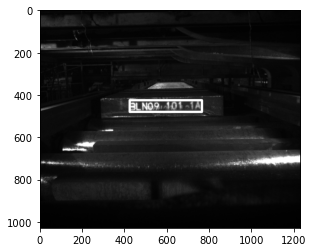

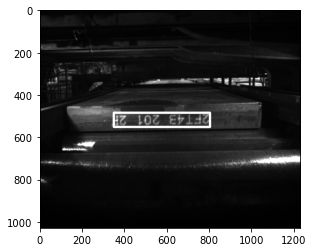

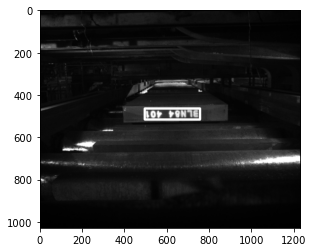

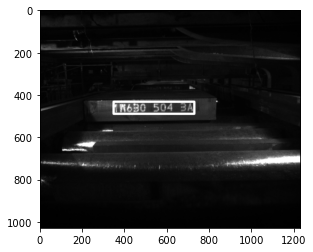

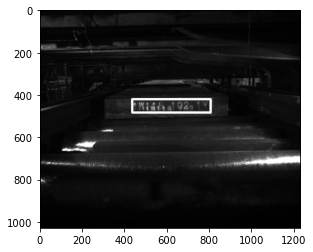

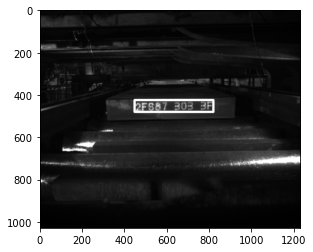

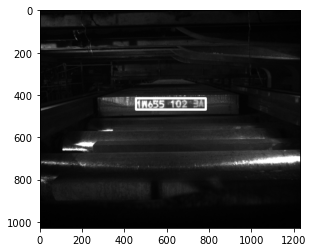

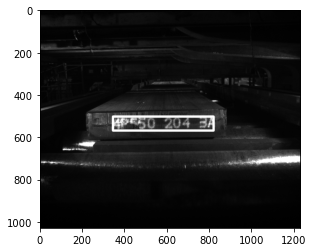

TRAIN GIOU loss: 0.06723 Focal: 0.06723
TRAIN GIOU loss: 0.06619 Focal: 0.06619
TRAIN GIOU loss: 0.07466 Focal: 0.07466
TRAIN GIOU loss: 0.07373 Focal: 0.07373
TRAIN GIOU loss: 0.07353 Focal: 0.07353
TRAIN GIOU loss: 0.07356 Focal: 0.07356
TRAIN GIOU loss: 0.07458 Focal: 0.07458
TRAIN GIOU loss: 0.07510 Focal: 0.07510
TRAIN GIOU loss: 0.07503 Focal: 0.07503
TRAIN GIOU loss: 0.07463 Focal: 0.07463
TRAIN GIOU loss: 0.07457 Focal: 0.07457
TRAIN GIOU loss: 0.07475 Focal: 0.07475
TRAIN GIOU loss: 0.07479 Focal: 0.07479
TRAIN GIOU loss: 0.07486 Focal: 0.07486
TRAIN GIOU loss: 0.07547 Focal: 0.07547
TRAIN GIOU loss: 0.07597 Focal: 0.07597
TRAIN GIOU loss: 0.07602 Focal: 0.07602
TRAIN GIOU loss: 0.07642 Focal: 0.07642
TRAIN GIOU loss: 0.07601 Focal: 0.07601
TRAIN GIOU loss: 0.07641 Focal: 0.07641
TRAIN GIOU loss: 0.07599 Focal: 0.07599
TRAIN GIOU loss: 0.07612 Focal: 0.07612
TRAIN GIOU loss: 0.07596 Focal: 0.07596
TRAIN GIOU loss: 0.07595 Focal: 0.07595
TRAIN GIOU loss: 0.07595 Focal: 0.07595


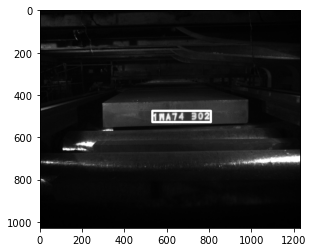

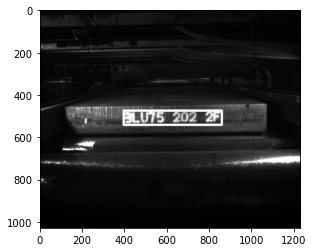

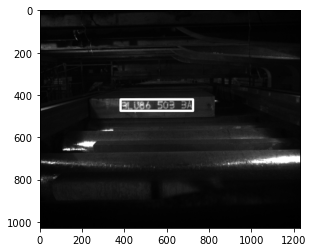

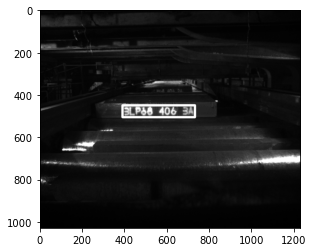

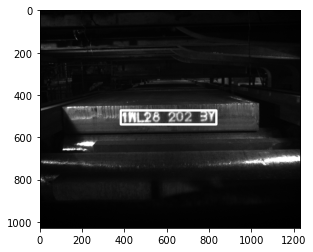

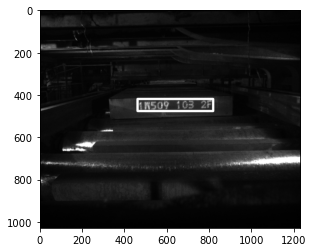

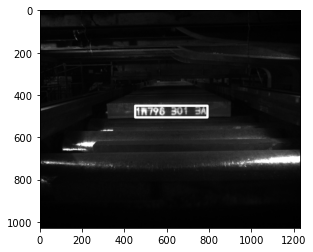

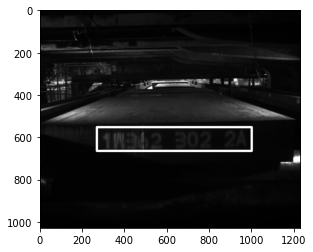

TRAIN GIOU loss: 0.06780 Focal: 0.06780
TRAIN GIOU loss: 0.07305 Focal: 0.07305
TRAIN GIOU loss: 0.07871 Focal: 0.07871
TRAIN GIOU loss: 0.08098 Focal: 0.08098
TRAIN GIOU loss: 0.07883 Focal: 0.07883
TRAIN GIOU loss: 0.07683 Focal: 0.07683
TRAIN GIOU loss: 0.07684 Focal: 0.07684
TRAIN GIOU loss: 0.07566 Focal: 0.07566
TRAIN GIOU loss: 0.07558 Focal: 0.07558
TRAIN GIOU loss: 0.07577 Focal: 0.07577
TRAIN GIOU loss: 0.07529 Focal: 0.07529
TRAIN GIOU loss: 0.07599 Focal: 0.07599
TRAIN GIOU loss: 0.07579 Focal: 0.07579
TRAIN GIOU loss: 0.07527 Focal: 0.07527
TRAIN GIOU loss: 0.07527 Focal: 0.07527
TRAIN GIOU loss: 0.07540 Focal: 0.07540
TRAIN GIOU loss: 0.07543 Focal: 0.07543
TRAIN GIOU loss: 0.07556 Focal: 0.07556
TRAIN GIOU loss: 0.07541 Focal: 0.07541
TRAIN GIOU loss: 0.07511 Focal: 0.07511
TRAIN GIOU loss: 0.07535 Focal: 0.07535
TRAIN GIOU loss: 0.07529 Focal: 0.07529
TRAIN GIOU loss: 0.07540 Focal: 0.07540
TRAIN GIOU loss: 0.07526 Focal: 0.07526
TRAIN GIOU loss: 0.07520 Focal: 0.07520


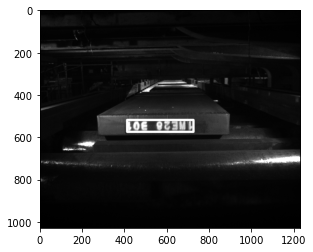

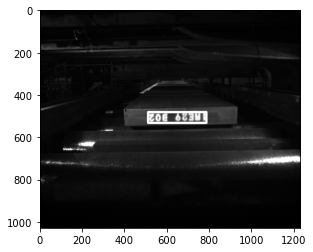

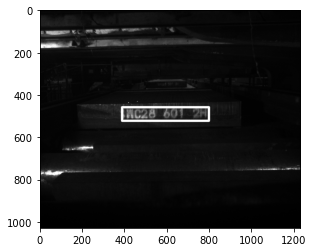

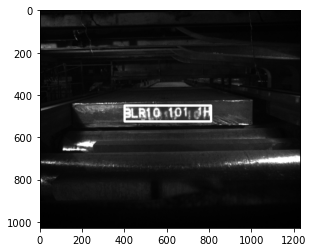

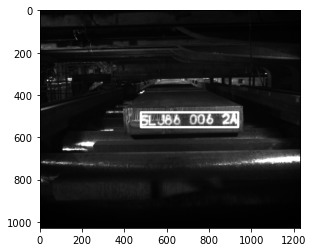

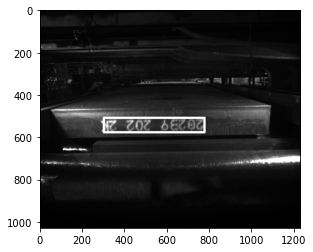

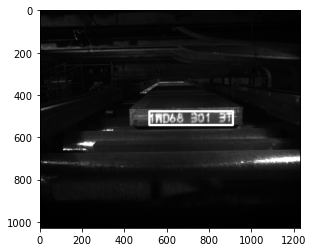

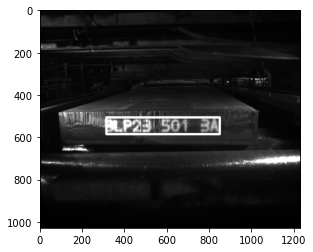

TRAIN GIOU loss: 0.08363 Focal: 0.08363
TRAIN GIOU loss: 0.07773 Focal: 0.07773
TRAIN GIOU loss: 0.07977 Focal: 0.07977
TRAIN GIOU loss: 0.07982 Focal: 0.07982
TRAIN GIOU loss: 0.07914 Focal: 0.07914
TRAIN GIOU loss: 0.07790 Focal: 0.07790
TRAIN GIOU loss: 0.07783 Focal: 0.07783
TRAIN GIOU loss: 0.07760 Focal: 0.07760
TRAIN GIOU loss: 0.07715 Focal: 0.07715
TRAIN GIOU loss: 0.07719 Focal: 0.07719
TRAIN GIOU loss: 0.07728 Focal: 0.07728
TRAIN GIOU loss: 0.07635 Focal: 0.07635
TRAIN GIOU loss: 0.07576 Focal: 0.07576
TRAIN GIOU loss: 0.07588 Focal: 0.07588
TRAIN GIOU loss: 0.07580 Focal: 0.07580
TRAIN GIOU loss: 0.07576 Focal: 0.07576
TRAIN GIOU loss: 0.07571 Focal: 0.07571
TRAIN GIOU loss: 0.07555 Focal: 0.07555
TRAIN GIOU loss: 0.07545 Focal: 0.07545
TRAIN GIOU loss: 0.07494 Focal: 0.07494
TRAIN GIOU loss: 0.07494 Focal: 0.07494
TRAIN GIOU loss: 0.07464 Focal: 0.07464
TRAIN GIOU loss: 0.07487 Focal: 0.07487
TRAIN GIOU loss: 0.07517 Focal: 0.07517
TRAIN GIOU loss: 0.07533 Focal: 0.07533


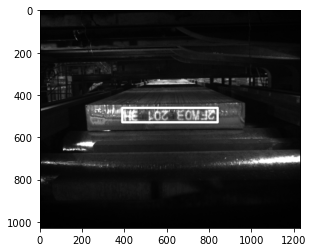

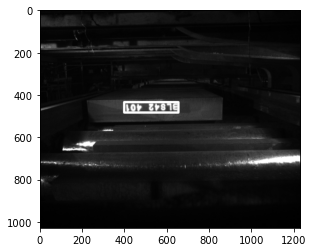

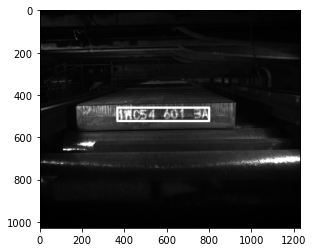

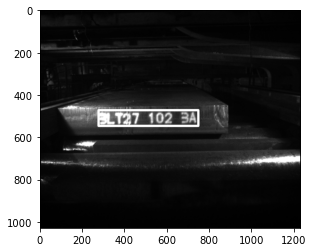

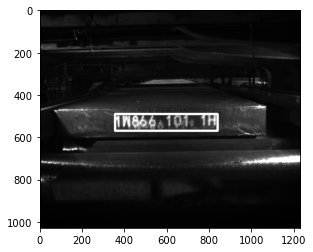

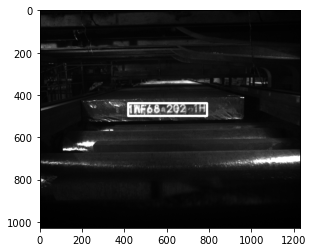

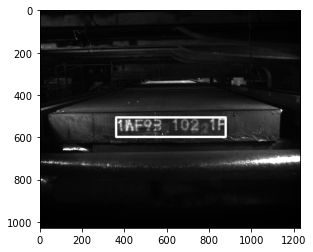

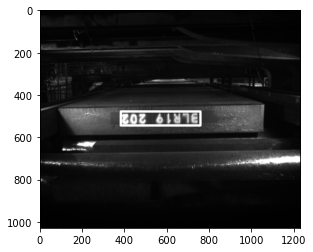

TRAIN GIOU loss: 0.06715 Focal: 0.06715
TRAIN GIOU loss: 0.07193 Focal: 0.07193
TRAIN GIOU loss: 0.07225 Focal: 0.07225
TRAIN GIOU loss: 0.07113 Focal: 0.07113
TRAIN GIOU loss: 0.07074 Focal: 0.07074
TRAIN GIOU loss: 0.07108 Focal: 0.07108
TRAIN GIOU loss: 0.07081 Focal: 0.07081
TRAIN GIOU loss: 0.07120 Focal: 0.07120
TRAIN GIOU loss: 0.07182 Focal: 0.07182
TRAIN GIOU loss: 0.07142 Focal: 0.07142
TRAIN GIOU loss: 0.07151 Focal: 0.07151
TRAIN GIOU loss: 0.07255 Focal: 0.07255
TRAIN GIOU loss: 0.07219 Focal: 0.07219
TRAIN GIOU loss: 0.07257 Focal: 0.07257
TRAIN GIOU loss: 0.07268 Focal: 0.07268
TRAIN GIOU loss: 0.07284 Focal: 0.07284
TRAIN GIOU loss: 0.07316 Focal: 0.07316
TRAIN GIOU loss: 0.07329 Focal: 0.07329
TRAIN GIOU loss: 0.07297 Focal: 0.07297
TRAIN GIOU loss: 0.07311 Focal: 0.07311
TRAIN GIOU loss: 0.07286 Focal: 0.07286
TRAIN GIOU loss: 0.07346 Focal: 0.07346
TRAIN GIOU loss: 0.07356 Focal: 0.07356
TRAIN GIOU loss: 0.07401 Focal: 0.07401
TRAIN GIOU loss: 0.07424 Focal: 0.07424


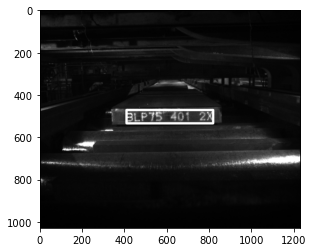

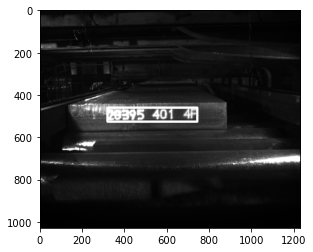

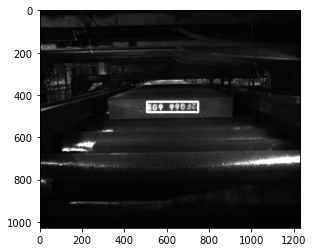

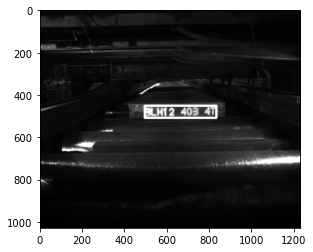

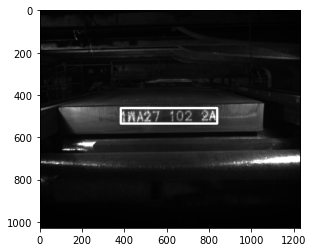

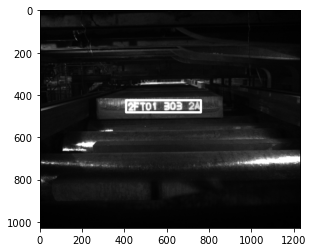

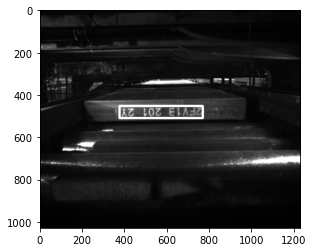

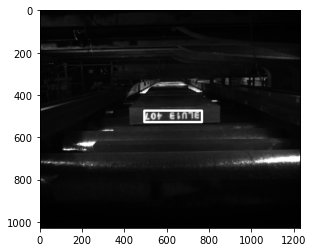

TRAIN GIOU loss: 0.08338 Focal: 0.08338
TRAIN GIOU loss: 0.07171 Focal: 0.07171
TRAIN GIOU loss: 0.07074 Focal: 0.07074
TRAIN GIOU loss: 0.07383 Focal: 0.07383
TRAIN GIOU loss: 0.07266 Focal: 0.07266
TRAIN GIOU loss: 0.07201 Focal: 0.07201
TRAIN GIOU loss: 0.07297 Focal: 0.07297
TRAIN GIOU loss: 0.07263 Focal: 0.07263
TRAIN GIOU loss: 0.07185 Focal: 0.07185
TRAIN GIOU loss: 0.07295 Focal: 0.07295
TRAIN GIOU loss: 0.07252 Focal: 0.07252
TRAIN GIOU loss: 0.07316 Focal: 0.07316
TRAIN GIOU loss: 0.07430 Focal: 0.07430
TRAIN GIOU loss: 0.07437 Focal: 0.07437
TRAIN GIOU loss: 0.07465 Focal: 0.07465
TRAIN GIOU loss: 0.07424 Focal: 0.07424
TRAIN GIOU loss: 0.07440 Focal: 0.07440
TRAIN GIOU loss: 0.07456 Focal: 0.07456
TRAIN GIOU loss: 0.07516 Focal: 0.07516
TRAIN GIOU loss: 0.07528 Focal: 0.07528
TRAIN GIOU loss: 0.07527 Focal: 0.07527
TRAIN GIOU loss: 0.07542 Focal: 0.07542
TRAIN GIOU loss: 0.07501 Focal: 0.07501
TRAIN GIOU loss: 0.07514 Focal: 0.07514
TRAIN GIOU loss: 0.07520 Focal: 0.07520


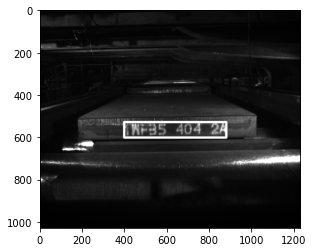

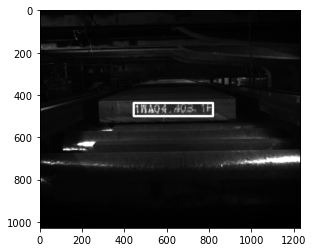

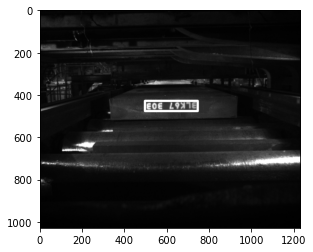

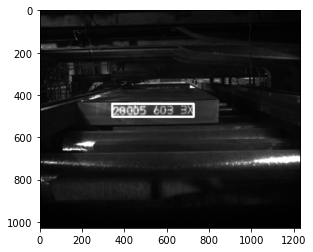

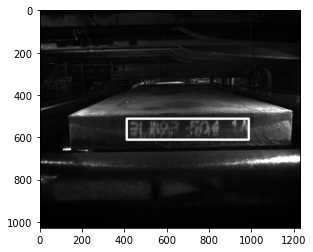

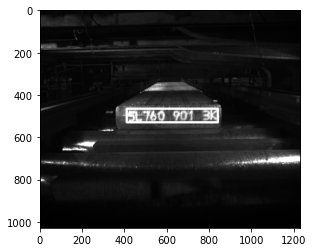

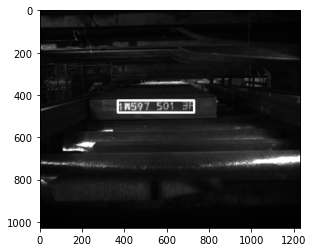

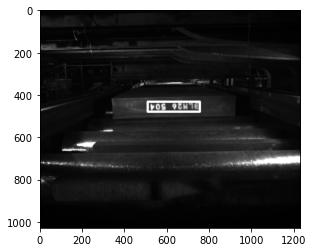

TRAIN GIOU loss: 0.06803 Focal: 0.06803
TRAIN GIOU loss: 0.07197 Focal: 0.07197
TRAIN GIOU loss: 0.07186 Focal: 0.07186
TRAIN GIOU loss: 0.07050 Focal: 0.07050
TRAIN GIOU loss: 0.07044 Focal: 0.07044
TRAIN GIOU loss: 0.07086 Focal: 0.07086
TRAIN GIOU loss: 0.07102 Focal: 0.07102
TRAIN GIOU loss: 0.07159 Focal: 0.07159
TRAIN GIOU loss: 0.07209 Focal: 0.07209
TRAIN GIOU loss: 0.07128 Focal: 0.07128
TRAIN GIOU loss: 0.07162 Focal: 0.07162
TRAIN GIOU loss: 0.07154 Focal: 0.07154
TRAIN GIOU loss: 0.07145 Focal: 0.07145
TRAIN GIOU loss: 0.07122 Focal: 0.07122
TRAIN GIOU loss: 0.07183 Focal: 0.07183
TRAIN GIOU loss: 0.07194 Focal: 0.07194
TRAIN GIOU loss: 0.07250 Focal: 0.07250
TRAIN GIOU loss: 0.07235 Focal: 0.07235
TRAIN GIOU loss: 0.07249 Focal: 0.07249
TRAIN GIOU loss: 0.07264 Focal: 0.07264
TRAIN GIOU loss: 0.07230 Focal: 0.07230
TRAIN GIOU loss: 0.07257 Focal: 0.07257
TRAIN GIOU loss: 0.07215 Focal: 0.07215
TRAIN GIOU loss: 0.07224 Focal: 0.07224
TRAIN GIOU loss: 0.07231 Focal: 0.07231


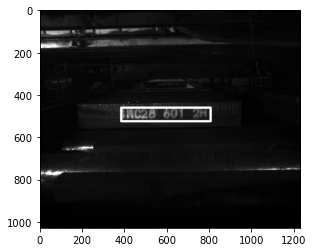

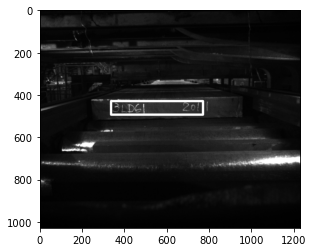

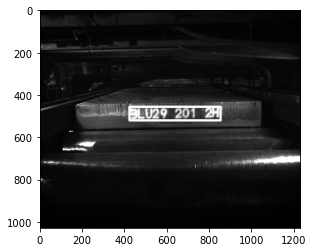

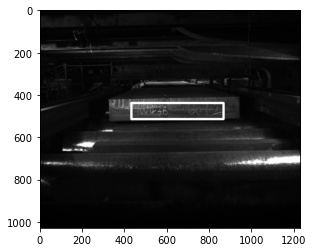

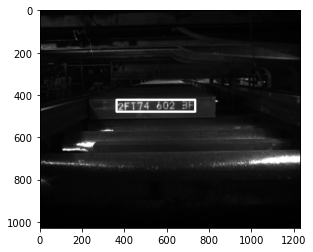

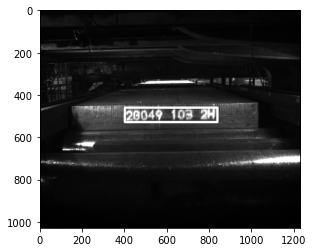

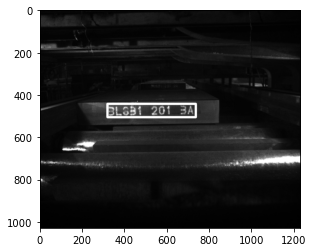

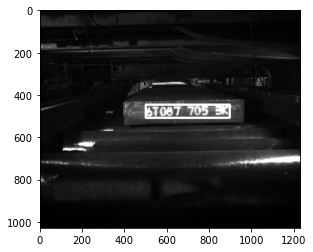

TRAIN GIOU loss: 0.05807 Focal: 0.05807
TRAIN GIOU loss: 0.06392 Focal: 0.06392
TRAIN GIOU loss: 0.06470 Focal: 0.06470
TRAIN GIOU loss: 0.06561 Focal: 0.06561
TRAIN GIOU loss: 0.06666 Focal: 0.06666
TRAIN GIOU loss: 0.06820 Focal: 0.06820
TRAIN GIOU loss: 0.06804 Focal: 0.06804
TRAIN GIOU loss: 0.06840 Focal: 0.06840
TRAIN GIOU loss: 0.06840 Focal: 0.06840
TRAIN GIOU loss: 0.06919 Focal: 0.06919
TRAIN GIOU loss: 0.06926 Focal: 0.06926
TRAIN GIOU loss: 0.06958 Focal: 0.06958
TRAIN GIOU loss: 0.06980 Focal: 0.06980
TRAIN GIOU loss: 0.06935 Focal: 0.06935
TRAIN GIOU loss: 0.06969 Focal: 0.06969
TRAIN GIOU loss: 0.07001 Focal: 0.07001
TRAIN GIOU loss: 0.07019 Focal: 0.07019
TRAIN GIOU loss: 0.06999 Focal: 0.06999
TRAIN GIOU loss: 0.06958 Focal: 0.06958
TRAIN GIOU loss: 0.06941 Focal: 0.06941
TRAIN GIOU loss: 0.06935 Focal: 0.06935
TRAIN GIOU loss: 0.06930 Focal: 0.06930
TRAIN GIOU loss: 0.06946 Focal: 0.06946
TRAIN GIOU loss: 0.06963 Focal: 0.06963
TRAIN GIOU loss: 0.06999 Focal: 0.06999


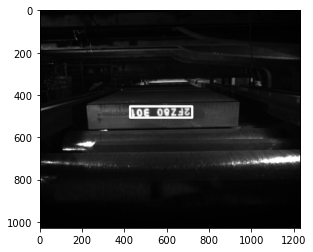

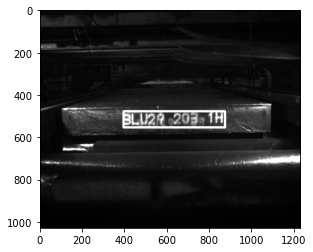

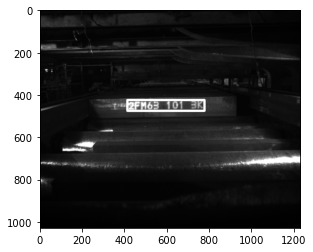

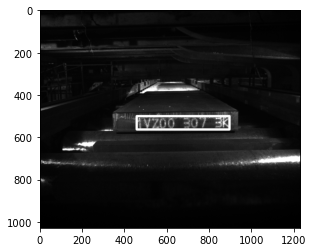

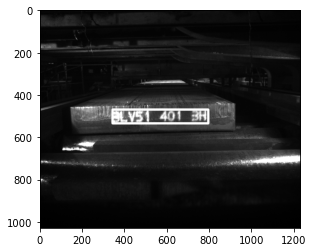

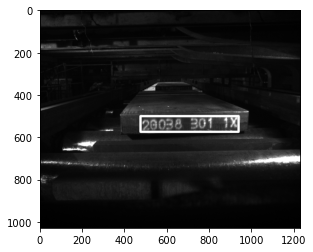

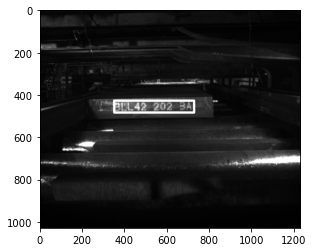

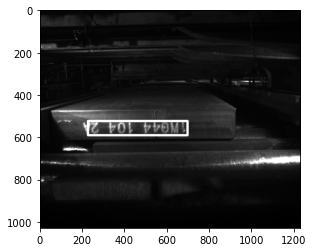

TRAIN GIOU loss: 0.07708 Focal: 0.07708
TRAIN GIOU loss: 0.07044 Focal: 0.07044
TRAIN GIOU loss: 0.07451 Focal: 0.07451
TRAIN GIOU loss: 0.07196 Focal: 0.07196
TRAIN GIOU loss: 0.07167 Focal: 0.07167
TRAIN GIOU loss: 0.07228 Focal: 0.07228
TRAIN GIOU loss: 0.07181 Focal: 0.07181
TRAIN GIOU loss: 0.07151 Focal: 0.07151
TRAIN GIOU loss: 0.07105 Focal: 0.07105
TRAIN GIOU loss: 0.07169 Focal: 0.07169
TRAIN GIOU loss: 0.07094 Focal: 0.07094
TRAIN GIOU loss: 0.07119 Focal: 0.07119
TRAIN GIOU loss: 0.07080 Focal: 0.07080
TRAIN GIOU loss: 0.07134 Focal: 0.07134
TRAIN GIOU loss: 0.07099 Focal: 0.07099
TRAIN GIOU loss: 0.07095 Focal: 0.07095
TRAIN GIOU loss: 0.07130 Focal: 0.07130
TRAIN GIOU loss: 0.07117 Focal: 0.07117
TRAIN GIOU loss: 0.07102 Focal: 0.07102
TRAIN GIOU loss: 0.07160 Focal: 0.07160
TRAIN GIOU loss: 0.07158 Focal: 0.07158
TRAIN GIOU loss: 0.07151 Focal: 0.07151
TRAIN GIOU loss: 0.07148 Focal: 0.07148
TRAIN GIOU loss: 0.07116 Focal: 0.07116
TRAIN GIOU loss: 0.07092 Focal: 0.07092


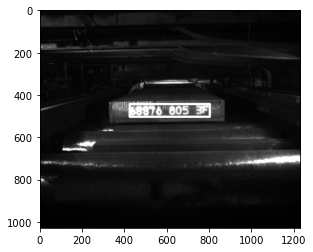

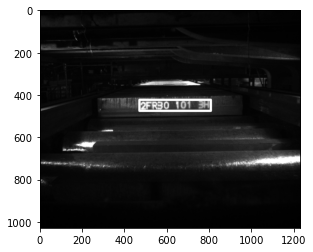

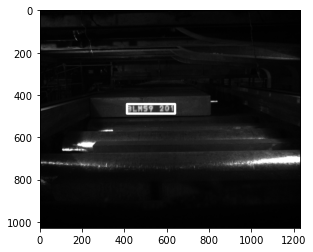

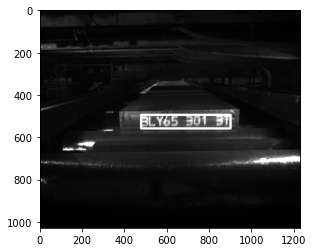

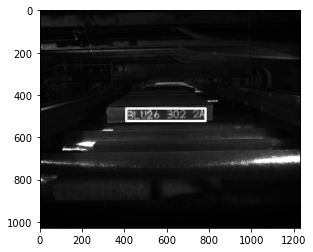

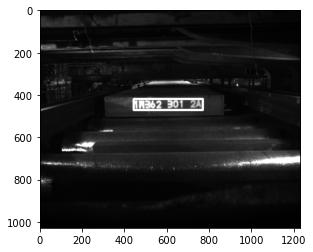

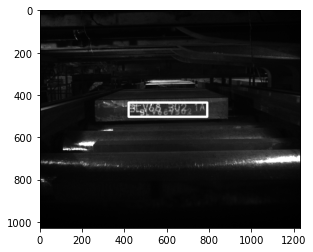

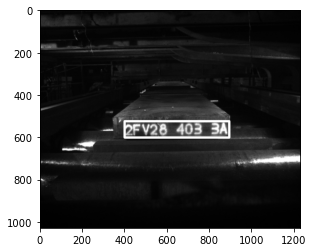

TRAIN GIOU loss: 0.07278 Focal: 0.07278
TRAIN GIOU loss: 0.07449 Focal: 0.07449
TRAIN GIOU loss: 0.07146 Focal: 0.07146
TRAIN GIOU loss: 0.07273 Focal: 0.07273
TRAIN GIOU loss: 0.07298 Focal: 0.07298
TRAIN GIOU loss: 0.07126 Focal: 0.07126
TRAIN GIOU loss: 0.07149 Focal: 0.07149
TRAIN GIOU loss: 0.07191 Focal: 0.07191
TRAIN GIOU loss: 0.07303 Focal: 0.07303
TRAIN GIOU loss: 0.07296 Focal: 0.07296
TRAIN GIOU loss: 0.07281 Focal: 0.07281
TRAIN GIOU loss: 0.07218 Focal: 0.07218
TRAIN GIOU loss: 0.07206 Focal: 0.07206
TRAIN GIOU loss: 0.07160 Focal: 0.07160
TRAIN GIOU loss: 0.07151 Focal: 0.07151
TRAIN GIOU loss: 0.07132 Focal: 0.07132
TRAIN GIOU loss: 0.07144 Focal: 0.07144
TRAIN GIOU loss: 0.07158 Focal: 0.07158
TRAIN GIOU loss: 0.07127 Focal: 0.07127
TRAIN GIOU loss: 0.07095 Focal: 0.07095
TRAIN GIOU loss: 0.07083 Focal: 0.07083
TRAIN GIOU loss: 0.07068 Focal: 0.07068
TRAIN GIOU loss: 0.07022 Focal: 0.07022
TRAIN GIOU loss: 0.07013 Focal: 0.07013
TRAIN GIOU loss: 0.06989 Focal: 0.06989


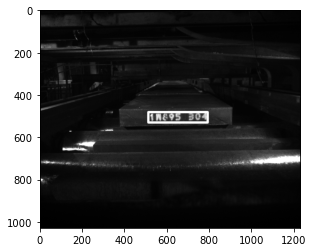

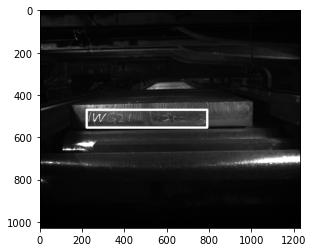

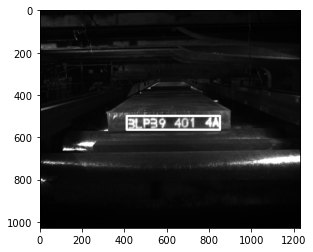

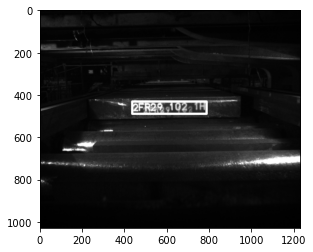

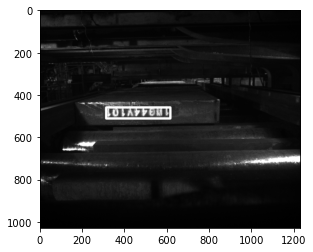

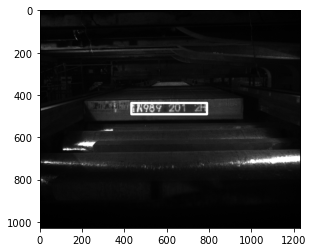

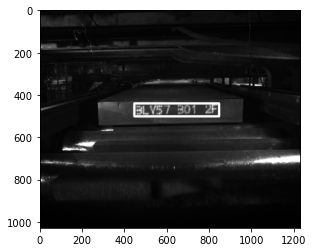

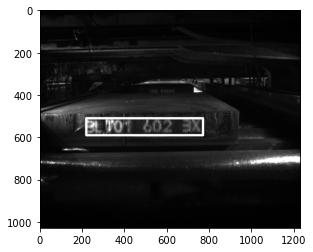

TRAIN GIOU loss: 0.07746 Focal: 0.07746
TRAIN GIOU loss: 0.07208 Focal: 0.07208
TRAIN GIOU loss: 0.07156 Focal: 0.07156
TRAIN GIOU loss: 0.06986 Focal: 0.06986
TRAIN GIOU loss: 0.06853 Focal: 0.06853
TRAIN GIOU loss: 0.06884 Focal: 0.06884
TRAIN GIOU loss: 0.06752 Focal: 0.06752
TRAIN GIOU loss: 0.06792 Focal: 0.06792
TRAIN GIOU loss: 0.06906 Focal: 0.06906
TRAIN GIOU loss: 0.06883 Focal: 0.06883
TRAIN GIOU loss: 0.06941 Focal: 0.06941
TRAIN GIOU loss: 0.06908 Focal: 0.06908
TRAIN GIOU loss: 0.06877 Focal: 0.06877
TRAIN GIOU loss: 0.06849 Focal: 0.06849
TRAIN GIOU loss: 0.06864 Focal: 0.06864
TRAIN GIOU loss: 0.06841 Focal: 0.06841
TRAIN GIOU loss: 0.06805 Focal: 0.06805
TRAIN GIOU loss: 0.06796 Focal: 0.06796
TRAIN GIOU loss: 0.06805 Focal: 0.06805
TRAIN GIOU loss: 0.06815 Focal: 0.06815
TRAIN GIOU loss: 0.06803 Focal: 0.06803
TRAIN GIOU loss: 0.06806 Focal: 0.06806
TRAIN GIOU loss: 0.06827 Focal: 0.06827
TRAIN GIOU loss: 0.06811 Focal: 0.06811
TRAIN GIOU loss: 0.06812 Focal: 0.06812


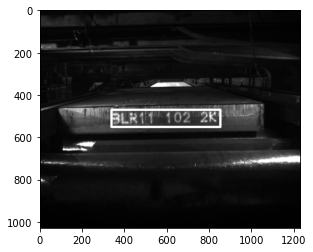

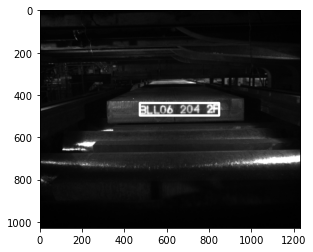

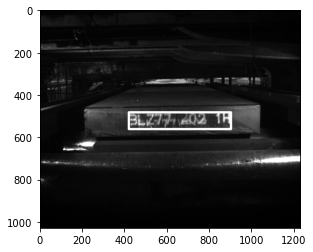

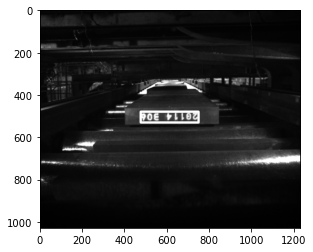

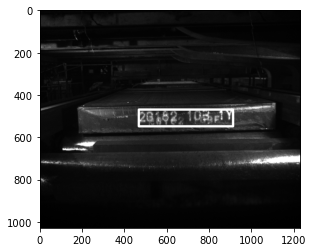

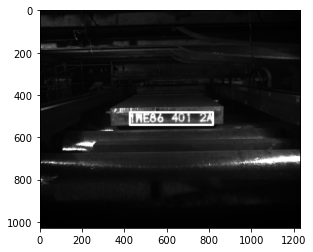

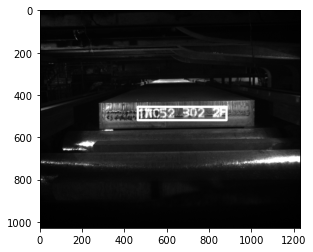

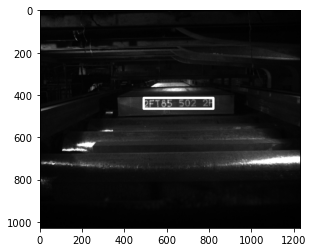

TRAIN GIOU loss: 0.08927 Focal: 0.08927
TRAIN GIOU loss: 0.06870 Focal: 0.06870
TRAIN GIOU loss: 0.07027 Focal: 0.07027
TRAIN GIOU loss: 0.07057 Focal: 0.07057
TRAIN GIOU loss: 0.07109 Focal: 0.07109
TRAIN GIOU loss: 0.07116 Focal: 0.07116
TRAIN GIOU loss: 0.07040 Focal: 0.07040
TRAIN GIOU loss: 0.07065 Focal: 0.07065
TRAIN GIOU loss: 0.07178 Focal: 0.07178
TRAIN GIOU loss: 0.07242 Focal: 0.07242
TRAIN GIOU loss: 0.07306 Focal: 0.07306
TRAIN GIOU loss: 0.07235 Focal: 0.07235
TRAIN GIOU loss: 0.07197 Focal: 0.07197
TRAIN GIOU loss: 0.07147 Focal: 0.07147
TRAIN GIOU loss: 0.07164 Focal: 0.07164
TRAIN GIOU loss: 0.07127 Focal: 0.07127
TRAIN GIOU loss: 0.07100 Focal: 0.07100
TRAIN GIOU loss: 0.07082 Focal: 0.07082
TRAIN GIOU loss: 0.07151 Focal: 0.07151
TRAIN GIOU loss: 0.07147 Focal: 0.07147
TRAIN GIOU loss: 0.07167 Focal: 0.07167
TRAIN GIOU loss: 0.07152 Focal: 0.07152
TRAIN GIOU loss: 0.07137 Focal: 0.07137
TRAIN GIOU loss: 0.07131 Focal: 0.07131
TRAIN GIOU loss: 0.07121 Focal: 0.07121


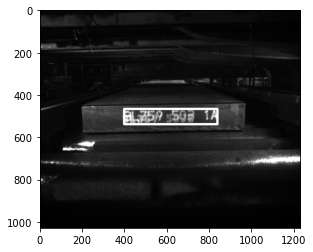

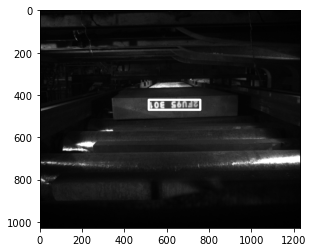

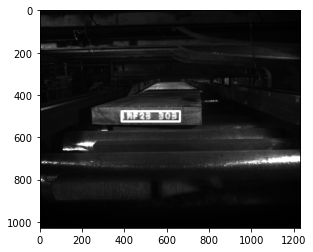

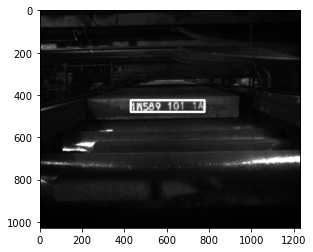

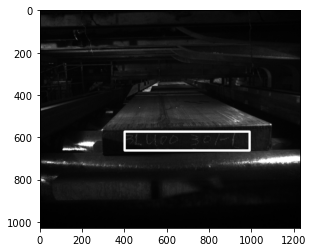

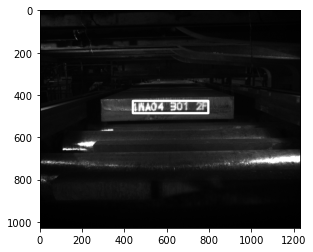

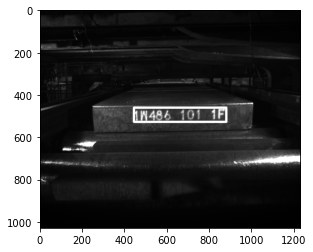

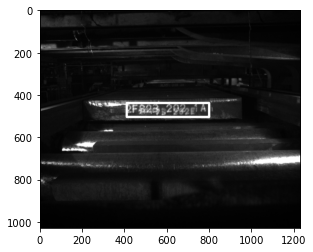

TRAIN GIOU loss: 0.08661 Focal: 0.08661
TRAIN GIOU loss: 0.07430 Focal: 0.07430
TRAIN GIOU loss: 0.07337 Focal: 0.07337
TRAIN GIOU loss: 0.07193 Focal: 0.07193
TRAIN GIOU loss: 0.07054 Focal: 0.07054
TRAIN GIOU loss: 0.07114 Focal: 0.07114
TRAIN GIOU loss: 0.07081 Focal: 0.07081
TRAIN GIOU loss: 0.07195 Focal: 0.07195
TRAIN GIOU loss: 0.07228 Focal: 0.07228
TRAIN GIOU loss: 0.07180 Focal: 0.07180
TRAIN GIOU loss: 0.07059 Focal: 0.07059
TRAIN GIOU loss: 0.07019 Focal: 0.07019
TRAIN GIOU loss: 0.06966 Focal: 0.06966
TRAIN GIOU loss: 0.06939 Focal: 0.06939
TRAIN GIOU loss: 0.06931 Focal: 0.06931
TRAIN GIOU loss: 0.06932 Focal: 0.06932
TRAIN GIOU loss: 0.06926 Focal: 0.06926
TRAIN GIOU loss: 0.06936 Focal: 0.06936
TRAIN GIOU loss: 0.06956 Focal: 0.06956
TRAIN GIOU loss: 0.06943 Focal: 0.06943
TRAIN GIOU loss: 0.06957 Focal: 0.06957
TRAIN GIOU loss: 0.06924 Focal: 0.06924
TRAIN GIOU loss: 0.06894 Focal: 0.06894
TRAIN GIOU loss: 0.06914 Focal: 0.06914
TRAIN GIOU loss: 0.06905 Focal: 0.06905


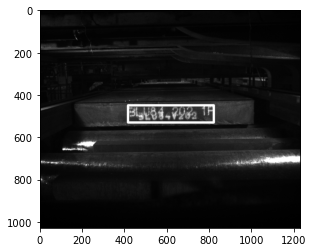

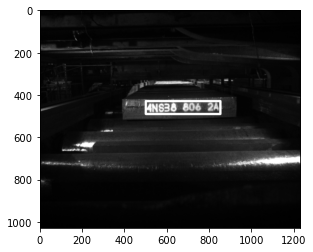

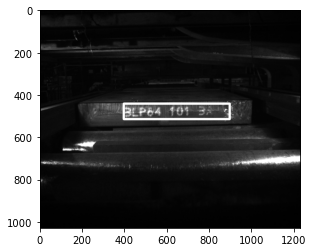

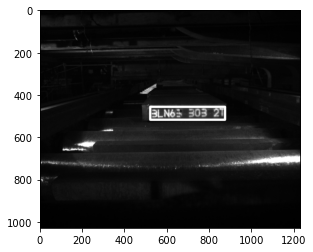

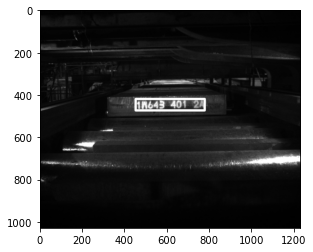

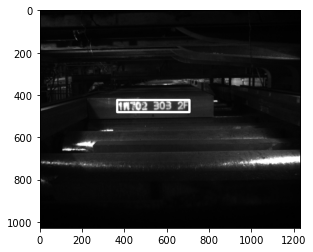

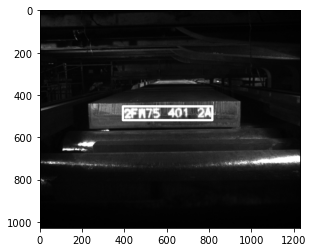

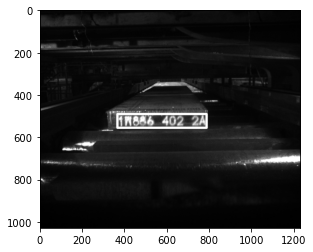

TRAIN GIOU loss: 0.05985 Focal: 0.05985
TRAIN GIOU loss: 0.05964 Focal: 0.05964
TRAIN GIOU loss: 0.06093 Focal: 0.06093
TRAIN GIOU loss: 0.06038 Focal: 0.06038
TRAIN GIOU loss: 0.06233 Focal: 0.06233
TRAIN GIOU loss: 0.06303 Focal: 0.06303
TRAIN GIOU loss: 0.06286 Focal: 0.06286
TRAIN GIOU loss: 0.06303 Focal: 0.06303
TRAIN GIOU loss: 0.06336 Focal: 0.06336
TRAIN GIOU loss: 0.06377 Focal: 0.06377
TRAIN GIOU loss: 0.06402 Focal: 0.06402
TRAIN GIOU loss: 0.06486 Focal: 0.06486
TRAIN GIOU loss: 0.06547 Focal: 0.06547
TRAIN GIOU loss: 0.06571 Focal: 0.06571
TRAIN GIOU loss: 0.06570 Focal: 0.06570
TRAIN GIOU loss: 0.06592 Focal: 0.06592
TRAIN GIOU loss: 0.06578 Focal: 0.06578
TRAIN GIOU loss: 0.06647 Focal: 0.06647
TRAIN GIOU loss: 0.06618 Focal: 0.06618
TRAIN GIOU loss: 0.06633 Focal: 0.06633
TRAIN GIOU loss: 0.06629 Focal: 0.06629
TRAIN GIOU loss: 0.06633 Focal: 0.06633
TRAIN GIOU loss: 0.06623 Focal: 0.06623
TRAIN GIOU loss: 0.06661 Focal: 0.06661
TRAIN GIOU loss: 0.06663 Focal: 0.06663


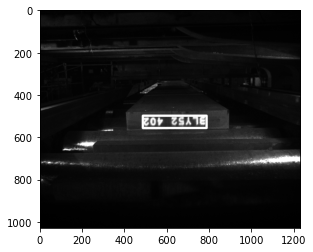

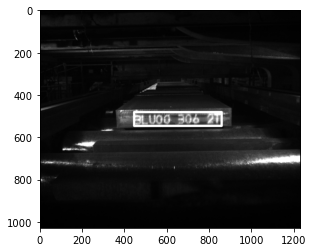

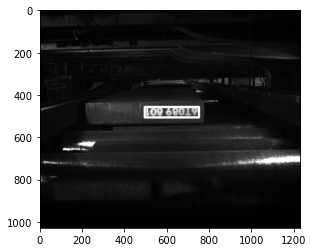

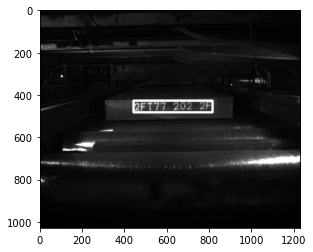

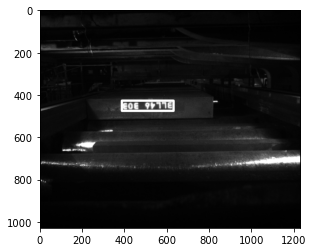

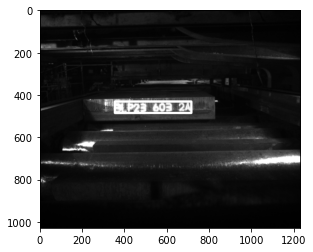

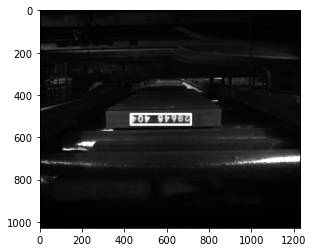

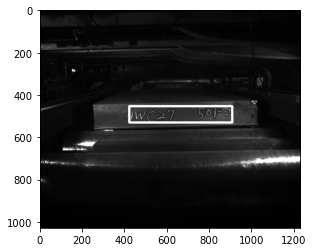

TRAIN GIOU loss: 0.06868 Focal: 0.06868
TRAIN GIOU loss: 0.06568 Focal: 0.06568
TRAIN GIOU loss: 0.06397 Focal: 0.06397
TRAIN GIOU loss: 0.06246 Focal: 0.06246
TRAIN GIOU loss: 0.06514 Focal: 0.06514
TRAIN GIOU loss: 0.06504 Focal: 0.06504
TRAIN GIOU loss: 0.06420 Focal: 0.06420
TRAIN GIOU loss: 0.06476 Focal: 0.06476
TRAIN GIOU loss: 0.06472 Focal: 0.06472
TRAIN GIOU loss: 0.06510 Focal: 0.06510
TRAIN GIOU loss: 0.06462 Focal: 0.06462
TRAIN GIOU loss: 0.06544 Focal: 0.06544
TRAIN GIOU loss: 0.06556 Focal: 0.06556
TRAIN GIOU loss: 0.06541 Focal: 0.06541
TRAIN GIOU loss: 0.06467 Focal: 0.06467
TRAIN GIOU loss: 0.06451 Focal: 0.06451
TRAIN GIOU loss: 0.06460 Focal: 0.06460
TRAIN GIOU loss: 0.06504 Focal: 0.06504
TRAIN GIOU loss: 0.06507 Focal: 0.06507
TRAIN GIOU loss: 0.06541 Focal: 0.06541
TRAIN GIOU loss: 0.06525 Focal: 0.06525
TRAIN GIOU loss: 0.06517 Focal: 0.06517
TRAIN GIOU loss: 0.06521 Focal: 0.06521
TRAIN GIOU loss: 0.06560 Focal: 0.06560
TRAIN GIOU loss: 0.06554 Focal: 0.06554


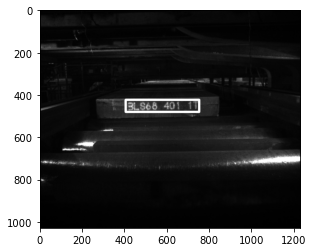

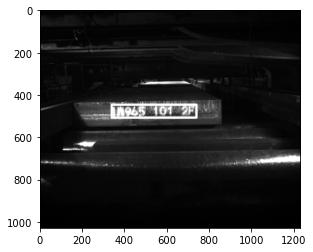

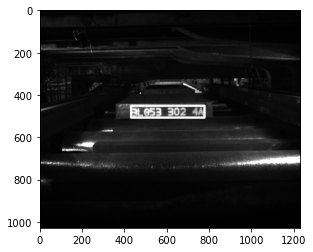

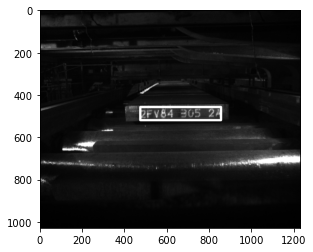

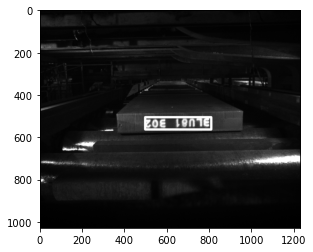

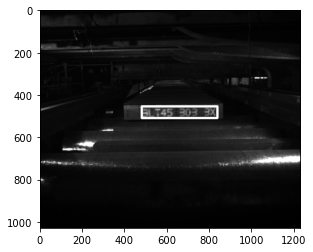

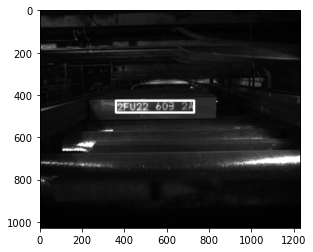

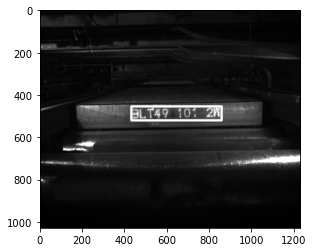

TRAIN GIOU loss: 0.07276 Focal: 0.07276
TRAIN GIOU loss: 0.06494 Focal: 0.06494
TRAIN GIOU loss: 0.06382 Focal: 0.06382
TRAIN GIOU loss: 0.06355 Focal: 0.06355
TRAIN GIOU loss: 0.06291 Focal: 0.06291
TRAIN GIOU loss: 0.06306 Focal: 0.06306
TRAIN GIOU loss: 0.06446 Focal: 0.06446
TRAIN GIOU loss: 0.06488 Focal: 0.06488
TRAIN GIOU loss: 0.06536 Focal: 0.06536
TRAIN GIOU loss: 0.06503 Focal: 0.06503
TRAIN GIOU loss: 0.06468 Focal: 0.06468
TRAIN GIOU loss: 0.06493 Focal: 0.06493
TRAIN GIOU loss: 0.06484 Focal: 0.06484
TRAIN GIOU loss: 0.06500 Focal: 0.06500
TRAIN GIOU loss: 0.06539 Focal: 0.06539
TRAIN GIOU loss: 0.06600 Focal: 0.06600
TRAIN GIOU loss: 0.06597 Focal: 0.06597
TRAIN GIOU loss: 0.06610 Focal: 0.06610
TRAIN GIOU loss: 0.06594 Focal: 0.06594
TRAIN GIOU loss: 0.06649 Focal: 0.06649
TRAIN GIOU loss: 0.06627 Focal: 0.06627
TRAIN GIOU loss: 0.06588 Focal: 0.06588
TRAIN GIOU loss: 0.06593 Focal: 0.06593
TRAIN GIOU loss: 0.06579 Focal: 0.06579
TRAIN GIOU loss: 0.06581 Focal: 0.06581


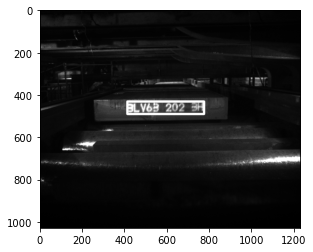

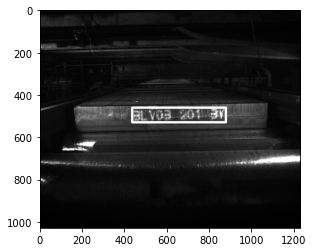

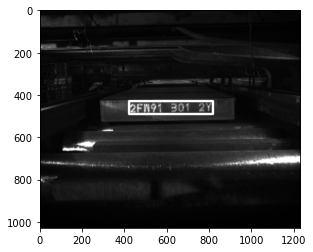

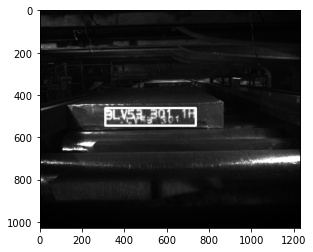

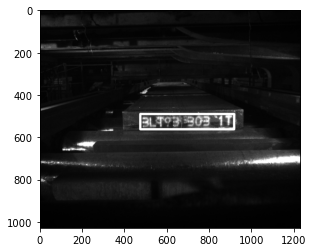

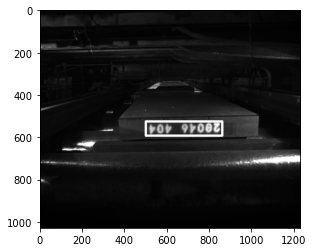

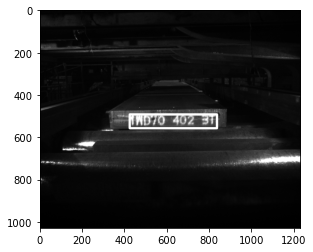

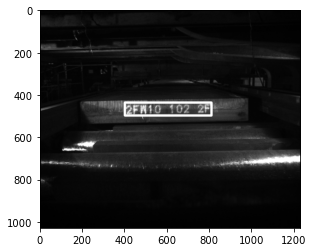

TRAIN GIOU loss: 0.07146 Focal: 0.07146
TRAIN GIOU loss: 0.06973 Focal: 0.06973
TRAIN GIOU loss: 0.06758 Focal: 0.06758
TRAIN GIOU loss: 0.06678 Focal: 0.06678
TRAIN GIOU loss: 0.06692 Focal: 0.06692
TRAIN GIOU loss: 0.06601 Focal: 0.06601
TRAIN GIOU loss: 0.06584 Focal: 0.06584
TRAIN GIOU loss: 0.06628 Focal: 0.06628
TRAIN GIOU loss: 0.06632 Focal: 0.06632
TRAIN GIOU loss: 0.06609 Focal: 0.06609
TRAIN GIOU loss: 0.06576 Focal: 0.06576
TRAIN GIOU loss: 0.06598 Focal: 0.06598
TRAIN GIOU loss: 0.06558 Focal: 0.06558
TRAIN GIOU loss: 0.06623 Focal: 0.06623
TRAIN GIOU loss: 0.06660 Focal: 0.06660
TRAIN GIOU loss: 0.06614 Focal: 0.06614
TRAIN GIOU loss: 0.06570 Focal: 0.06570
TRAIN GIOU loss: 0.06529 Focal: 0.06529
TRAIN GIOU loss: 0.06500 Focal: 0.06500
TRAIN GIOU loss: 0.06467 Focal: 0.06467
TRAIN GIOU loss: 0.06463 Focal: 0.06463
TRAIN GIOU loss: 0.06460 Focal: 0.06460
TRAIN GIOU loss: 0.06473 Focal: 0.06473
TRAIN GIOU loss: 0.06494 Focal: 0.06494
TRAIN GIOU loss: 0.06527 Focal: 0.06527


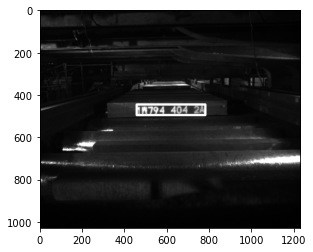

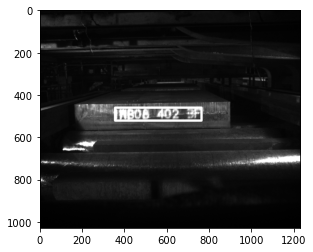

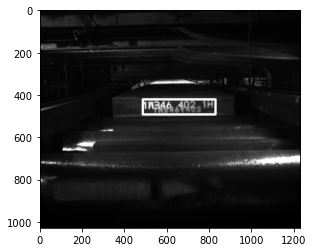

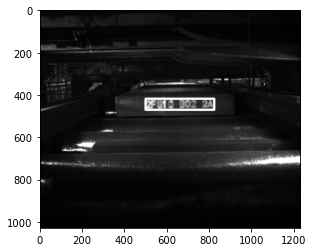

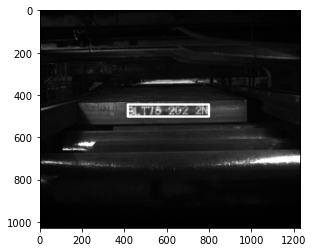

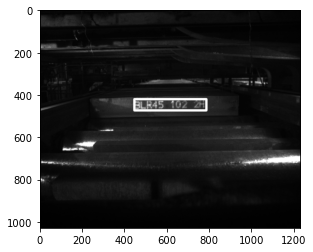

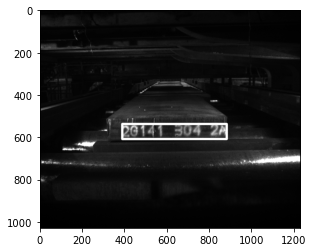

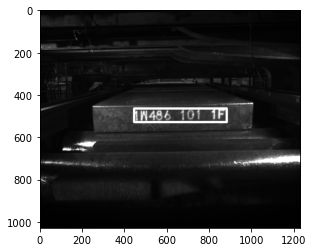

TRAIN GIOU loss: 0.05750 Focal: 0.05750
TRAIN GIOU loss: 0.06017 Focal: 0.06017
TRAIN GIOU loss: 0.06346 Focal: 0.06346
TRAIN GIOU loss: 0.06503 Focal: 0.06503
TRAIN GIOU loss: 0.06399 Focal: 0.06399
TRAIN GIOU loss: 0.06359 Focal: 0.06359
TRAIN GIOU loss: 0.06282 Focal: 0.06282
TRAIN GIOU loss: 0.06359 Focal: 0.06359
TRAIN GIOU loss: 0.06473 Focal: 0.06473
TRAIN GIOU loss: 0.06467 Focal: 0.06467
TRAIN GIOU loss: 0.06498 Focal: 0.06498
TRAIN GIOU loss: 0.06457 Focal: 0.06457
TRAIN GIOU loss: 0.06414 Focal: 0.06414
TRAIN GIOU loss: 0.06378 Focal: 0.06378
TRAIN GIOU loss: 0.06342 Focal: 0.06342
TRAIN GIOU loss: 0.06297 Focal: 0.06297
TRAIN GIOU loss: 0.06270 Focal: 0.06270
TRAIN GIOU loss: 0.06279 Focal: 0.06279
TRAIN GIOU loss: 0.06261 Focal: 0.06261
TRAIN GIOU loss: 0.06280 Focal: 0.06280
TRAIN GIOU loss: 0.06296 Focal: 0.06296
TRAIN GIOU loss: 0.06275 Focal: 0.06275
TRAIN GIOU loss: 0.06265 Focal: 0.06265
TRAIN GIOU loss: 0.06262 Focal: 0.06262
TRAIN GIOU loss: 0.06268 Focal: 0.06268


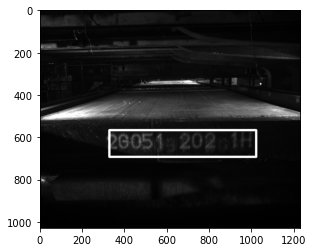

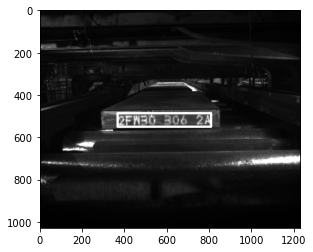

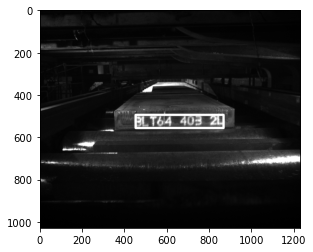

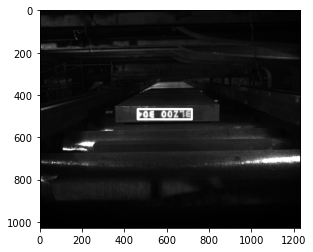

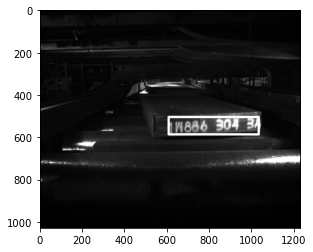

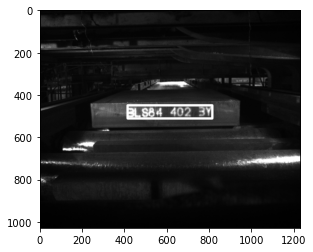

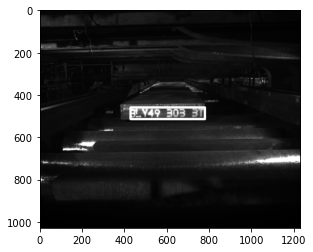

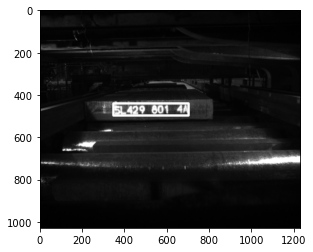

In [7]:
# %run train.py

In [8]:
# utils.save_weights('')

In [9]:
# utils.load_weights(model,'')

In [8]:
record = utils.segment(model,True)

In [9]:
# record.to_csv(r'D:\DL_competition_Dataset\ChinaSteel\dataset\custom\segment\record\test.csv',encoding='utf8',index=False)
record.to_csv(r'D:\DL_competition_Dataset\ChinaSteel\dataset\private\segment\record\private.csv',encoding='utf8',index=False)

In [11]:
record['aspect'] = record['w']/record['h']

In [14]:
(record['aspect']<4).sum()

6